In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/cryoet-monai-requirements/gunicorn-20.1.0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/pyasn1-0.6.1-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/docker-7.1.0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/graphene-3.4.3-py2.py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/urllib3-2.3.0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/opentelemetry_semantic_conventions-0.50b0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/tzdata-2025.1-py2.py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/fsspec-2024.12.0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/filelock-3.17.0-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/certifi-2024.12.14-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/smmap-5.0.2-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/alembic-1.14.1-py3-none-any.whl
/kaggle/input/cryoet-monai-requirements/click-8.1.8-py3-none-any.whl
/kaggle/input/cryoet-monai-requir

## Setup Instructions
Before running this notebook, please ensure you have added the dataset `cryoet-monai-requirements` and `copick` as input. Here's how:

1. Click on **Add Input** on the right side panel.
2. Search for `cryto`under **Competition Datasets** `cryoet-monai-requirements`,`copick` under **Datasets** and `model_60.pth`under **Models**.
3. Click the **+** to add it to your notebook.

Once added, the following cell will install the necessary packages:

In [2]:
!pip install --no-index --find-links=/kaggle/input/cryoet-monai-requirements -r /kaggle/input/cryoet-monai-requirements/requirements.txt
!pip install --no-deps --no-index --find-links=/kaggle/input/copick-utils/dependencies -r /kaggle/input/copick-utils/requirements.txt

Looking in links: /kaggle/input/cryoet-monai-requirements
Processing /kaggle/input/cryoet-monai-requirements/monai_weekly-1.5.dev2502-py3-none-any.whl (from -r /kaggle/input/cryoet-monai-requirements/requirements.txt (line 1))
Processing /kaggle/input/cryoet-monai-requirements/mlflow-2.19.0-py3-none-any.whl (from -r /kaggle/input/cryoet-monai-requirements/requirements.txt (line 5))
Processing /kaggle/input/cryoet-monai-requirements/mlflow_skinny-2.19.0-py3-none-any.whl (from mlflow==2.19.0->-r /kaggle/input/cryoet-monai-requirements/requirements.txt (line 5))
Processing /kaggle/input/cryoet-monai-requirements/graphene-3.4.3-py2.py3-none-any.whl (from mlflow==2.19.0->-r /kaggle/input/cryoet-monai-requirements/requirements.txt (line 5))
Processing /kaggle/input/cryoet-monai-requirements/gunicorn-20.1.0-py3-none-any.whl (from mlflow==2.19.0->-r /kaggle/input/cryoet-monai-requirements/requirements.txt (line 5))
Processing /kaggle/input/cryoet-monai-requirements/databricks_sdk-0.41.0-py3-no

In [3]:
# !ls /kaggle/input/

In [4]:
import monai
print(monai.__version__)

1.5.dev2502


In [5]:
# import tarfile
# tar = tarfile.open('/kaggle/input/copick-utils/dependencies/asciitree-0.3.3')
# tar.extractall(path='/kaggle/working/')
# tar.close()

# # Change to the directory where setup.py is located
# %cd /kaggle/working/asciitree-0.3.3
# !python setup.py install

# # Return to working directory
# %cd /kaggle/working/

In [6]:
# !pip install --no-index --find-links=/kaggle/input/copick copick-*.whl

In [7]:
# import subprocess
# import sys
# import re
# import pkg_resources

# def install_monai(use_weekly=False, version="1.4.0"):
#     """Installs either the latest stable version of MONAI or the weekly build.

#     Args:
#         use_weekly: If True, installs the weekly build. Otherwise, installs the
#             latest stable version.
#         version: The desired version of MONAI. Only applicable if use_weekly is False.

#     Returns:
#         True if installation was successful or the correct version was already installed, False otherwise.
#     """
#     try:
#         if use_weekly:
#             package_name = "monai-weekly"
#             required_version = None
#         else:
#             package_name = "monai"
#             required_version = version

#         # Check if MONAI is already installed and if the version is correct
#         installed = False
#         try:
#             installed_version = pkg_resources.get_distribution(package_name).version
#             installed = True
#             if required_version and installed_version != required_version:
#                 print(f"Installed {package_name} version ({installed_version}) does not match required version ({required_version}).")
#                 installed = False
#         except pkg_resources.DistributionNotFound:
#             pass

#         if installed:
#             print(f"{package_name} (version {installed_version}) is already installed.")
#             return True

#         # Install MONAI
#         if use_weekly:
#             install_command = [sys.executable, "-m", "pip", "install", "-U", "monai-weekly"]
#         else:
#             install_command = [sys.executable, "-m", "pip", "install", "-U", f"monai=={version}"]

#         subprocess.check_call(install_command)
#         print(f"Successfully installed {package_name} (version {version if not use_weekly else 'weekly build'}).")
#         return True

#     except subprocess.CalledProcessError as e:
#         print(f"Error installing {package_name}: {e}")
#         return False
#     except Exception as e:
#         print(f"An unexpected error occurred: {e}")
#         return False

# # --- Install MONAI ---
# # Choose whether to install the weekly build or the stable version
# if install_monai(use_weekly=False):
#     print("MONAI installation successful.")
# else:
#     print("MONAI installation failed.")
#     sys.exit(1)  # Exit with an error code if installation failed

# # Continue with the rest of your code only if MONAI installation was successful
# # Rest of your code that depends on MONAI...

In [8]:
# Make a copick project
import os
import shutil

config_blob = """{
    "name": "czii_cryoet_mlchallenge_2024",
    "description": "2024 CZII CryoET ML Challenge training data.",
    "version": "1.0.0",

    "pickable_objects": [
        {
            "name": "apo-ferritin",
            "is_particle": true,
            "pdb_id": "4V1W",
            "label": 1,
            "color": [  0, 117, 220, 128],
            "radius": 60,
            "map_threshold": 0.0418
        },
        {
            "name": "beta-galactosidase",
            "is_particle": true,
            "pdb_id": "6X1Q",
            "label": 3,
            "color": [ 76,   0,  92, 128],
            "radius": 90,
            "map_threshold": 0.0578
        },
        {
            "name": "ribosome",
            "is_particle": true,
            "pdb_id": "6EK0",
            "label": 4,
            "color": [  0,  92,  49, 128],
            "radius": 150,
            "map_threshold": 0.0374
        },
        {
            "name": "thyroglobulin",
            "is_particle": true,
            "pdb_id": "6SCJ",
            "label": 5,
            "color": [ 43, 206,  72, 128],
            "radius": 130,
            "map_threshold": 0.0278
        },
        {
            "name": "virus-like-particle",
            "is_particle": true,
            "label": 6,
            "color": [255, 204, 153, 128],
            "radius": 135,
            "map_threshold": 0.201
        },
        {
            "name": "membrane",
            "is_particle": false,
            "label": 8,
            "color": [100, 100, 100, 128]
        },
        {
            "name": "background",
            "is_particle": false,
            "label": 9,
            "color": [10, 150, 200, 128]
        }
    ],

    "overlay_root": "/kaggle/working/overlay",

    "overlay_fs_args": {
        "auto_mkdir": true
    },

    "static_root": "/kaggle/input/czii-cryo-et-object-identification/train/static"
}"""

copick_config_path = "/kaggle/working/copick.config"
output_overlay = "/kaggle/working/overlay"

with open(copick_config_path, "w") as f:
    f.write(config_blob)
    
# Update the overlay
# Define source and destination directories
source_dir = '/kaggle/input/czii-cryo-et-object-identification/train/overlay'
destination_dir = '/kaggle/working/overlay'

# Walk through the source directory
for root, dirs, files in os.walk(source_dir):
    # Create corresponding subdirectories in the destination
    relative_path = os.path.relpath(root, source_dir)
    target_dir = os.path.join(destination_dir, relative_path)
    os.makedirs(target_dir, exist_ok=True)
    
    # Copy and rename each file
    for file in files:
        if file.startswith("curation_0_"):
            new_filename = file
        else:
            new_filename = f"curation_0_{file}"
            
        
        # Define full paths for the source and destination files
        source_file = os.path.join(root, file)
        destination_file = os.path.join(target_dir, new_filename)
        
        # Copy the file with the new name
        shutil.copy2(source_file, destination_file)
        print(f"Copied {source_file} to {destination_file}")

Copied /kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns/TS_86_3/Picks/beta-amylase.json to /kaggle/working/overlay/ExperimentRuns/TS_86_3/Picks/curation_0_beta-amylase.json
Copied /kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns/TS_86_3/Picks/beta-galactosidase.json to /kaggle/working/overlay/ExperimentRuns/TS_86_3/Picks/curation_0_beta-galactosidase.json
Copied /kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns/TS_86_3/Picks/apo-ferritin.json to /kaggle/working/overlay/ExperimentRuns/TS_86_3/Picks/curation_0_apo-ferritin.json
Copied /kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns/TS_86_3/Picks/virus-like-particle.json to /kaggle/working/overlay/ExperimentRuns/TS_86_3/Picks/curation_0_virus-like-particle.json
Copied /kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns/TS_86_3/Picks/ribosome.json to /kaggle/working/overlay/ExperimentRuns/TS_86_3/Pic

## Importing libraries

In [9]:
import os
import numpy as np
from pathlib import Path
import torch
import torchinfo
import zarr, copick
from tqdm import tqdm
from monai.data import DataLoader, Dataset, CacheDataset, decollate_batch
from monai.transforms import (
    Compose, 
    EnsureChannelFirstd, 
    Orientationd,  
    AsDiscrete,  
    RandFlipd, 
    RandRotate90d, 
    NormalizeIntensityd,
    RandCropByLabelClassesd,
)
from monai.networks.nets import UNet
from monai.losses import DiceLoss, FocalLoss, TverskyLoss
from monai.metrics import DiceMetric, ConfusionMatrixMetric
import mlflow
import mlflow.pytorch

Prepare the Dataset

## 1. Get the copick root

In [10]:
import copick

root = copick.from_file(copick_config_path)

copick_user_name = "copickUtils"
copick_segmentation_name = "paintedPicks"
voxel_size = 10
tomo_type = "denoised"

## 2. Generate multi-class segmentation masks from picks, and saved them to the copick overlay directory (one-time)

In [11]:
from copick_utils.segmentation import segmentation_from_picks
import copick_utils.writers.write as write
from collections import defaultdict
import numpy as np
from tqdm import tqdm

# Just do this once
generate_masks = True

if generate_masks:
    target_objects = defaultdict(dict)
    for object in root.pickable_objects:
        if object.is_particle:
            target_objects[object.name]['label'] = object.label
            target_objects[object.name]['radius'] = object.radius

    for run in tqdm(root.runs, desc="Generating masks per run"):
        # Use get_tomograms instead of get_tomogram
        tomograms = run.get_voxel_spacing(10).get_tomograms(tomo_type)
        if not tomograms:
            print(f"No tomograms found for run {run.name}")
            continue
        tomo = tomograms[0].numpy()  # Assuming we take the first tomogram if multiple are available
        print(f"Tomogram shape: {tomo.shape}")  # Debug: Print tomogram shape
        
        target = np.zeros(tomo.shape, dtype=np.uint8)
        print(f"Initial target shape: {target.shape}, dtype: {target.dtype}") # Debug: Print initial target shape and dtype
        
        for pickable_object in root.pickable_objects:
            if pickable_object.is_particle:  # Only deal with particle objects
                picks = run.get_picks(object_name=pickable_object.name, user_id="curation")
                if picks:  # Check if there are any picks for this object
                    radius = target_objects[pickable_object.name]['radius'] * 0.8
                    label = target_objects[pickable_object.name]['label']
                    
                    # Assuming segmentation_from_picks has a method 'from_picks'
                    target = segmentation_from_picks.from_picks(picks[0], target, radius, label)
        
        # Writing the segmentation
        write.segmentation(run, target, copick_user_name, name=copick_segmentation_name)

Generating masks per run:   0%|          | 0/7 [00:00<?, ?it/s]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  14%|█▍        | 1/7 [00:03<00:18,  3.15s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  29%|██▊       | 2/7 [00:05<00:13,  2.65s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  43%|████▎     | 3/7 [00:07<00:09,  2.47s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  57%|█████▋    | 4/7 [00:09<00:07,  2.35s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  71%|███████▏  | 5/7 [00:12<00:04,  2.33s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run:  86%|████████▌ | 6/7 [00:14<00:02,  2.29s/it]

Tomogram shape: (184, 630, 630)
Initial target shape: (184, 630, 630), dtype: uint8


Generating masks per run: 100%|██████████| 7/7 [00:16<00:00,  2.37s/it]


## 3. Get tomograms and their segmentaion masks (from picks) arrays

In [12]:
from tqdm import tqdm
import numpy as np

# --- Data Loading ---
data_dicts = []
for run in tqdm(root.runs):
    tomograms = run.get_voxel_spacing(voxel_size).get_tomograms(tomo_type)
    if not tomograms:
        print(f"No tomograms found for run {run.name}")
        continue

    tomogram = tomograms[0].numpy()
    print(f"Tomogram shape for {run.name}: {tomogram.shape}")

    try:
        segmentations = run.get_segmentations(name=copick_segmentation_name, user_id=copick_user_name, voxel_size=voxel_size, is_multilabel=True)
        if not segmentations:
            print(f"No segmentations found for {run.name}")
            continue
        segmentation = segmentations[0].numpy()

        # Check if segmentation is all zeros
        if np.all(segmentation == 0):
            print(f"Segmentation for {run.name} is all zeros.")
        else:
            print(f"Segmentation for {run.name} has values: {np.unique(segmentation)}")

        data_dicts.append({"image": tomogram, "label": segmentation})
    except AttributeError:
        print(f"Method get_segmentations not available for run {run.name}")
    except IndexError:
        print(f"No segmentation data found for {run.name}")
    except Exception as e:
        print(f"Unexpected error getting segmentation for {run.name}: {e}")

if data_dicts:
    print(f"Unique labels in the first segmentation: {np.unique(data_dicts[0]['label'])}")
else:
    print("No data collected from runs.")

  0%|          | 0/7 [00:00<?, ?it/s]

Tomogram shape for TS_5_4: (184, 630, 630)


 14%|█▍        | 1/7 [00:02<00:15,  2.59s/it]

Segmentation for TS_5_4 has values: [0 1 3 4 5 6]
Tomogram shape for TS_69_2: (184, 630, 630)


 29%|██▊       | 2/7 [00:05<00:13,  2.63s/it]

Segmentation for TS_69_2 has values: [0 1 3 4 5 6]
Tomogram shape for TS_6_4: (184, 630, 630)


 43%|████▎     | 3/7 [00:07<00:10,  2.64s/it]

Segmentation for TS_6_4 has values: [0 1 3 4 5 6]
Tomogram shape for TS_6_6: (184, 630, 630)


 57%|█████▋    | 4/7 [00:10<00:07,  2.64s/it]

Segmentation for TS_6_6 has values: [0 1 3 4 5 6]
Tomogram shape for TS_73_6: (184, 630, 630)


 71%|███████▏  | 5/7 [00:13<00:05,  2.64s/it]

Segmentation for TS_73_6 has values: [0 1 3 4 5 6]
Tomogram shape for TS_86_3: (184, 630, 630)


 86%|████████▌ | 6/7 [00:15<00:02,  2.65s/it]

Segmentation for TS_86_3 has values: [0 1 3 4 5 6]
Tomogram shape for TS_99_9: (184, 630, 630)


100%|██████████| 7/7 [00:18<00:00,  2.65s/it]

Segmentation for TS_99_9 has values: [0 1 3 4 5 6]


Unique labels in the first segmentation: [0 1 3 4 5 6]


Processing Runs:   0%|          | 0/7 [00:00<?, ?run/s]

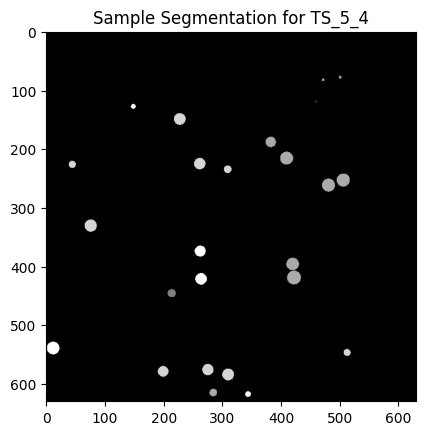

Processing Runs:  14%|█▍        | 1/7 [00:01<00:06,  1.16s/run]

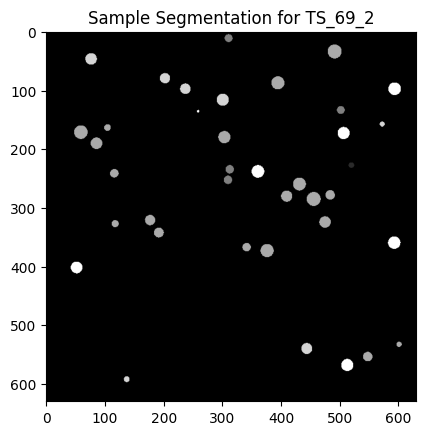

Processing Runs:  29%|██▊       | 2/7 [00:02<00:05,  1.15s/run]

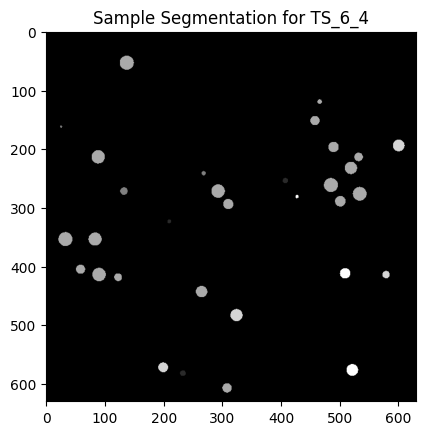

Processing Runs:  43%|████▎     | 3/7 [00:03<00:04,  1.14s/run]

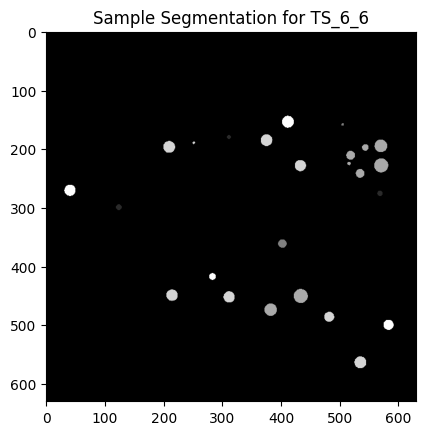

Processing Runs:  57%|█████▋    | 4/7 [00:04<00:03,  1.13s/run]

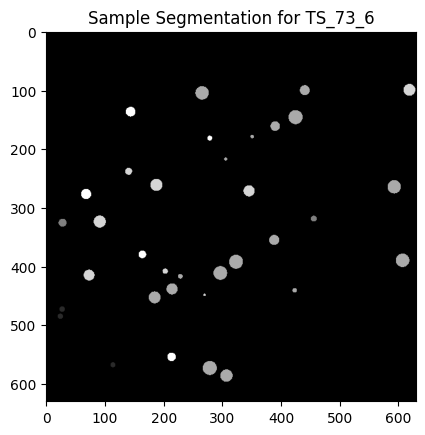

Processing Runs:  71%|███████▏  | 5/7 [00:05<00:02,  1.13s/run]

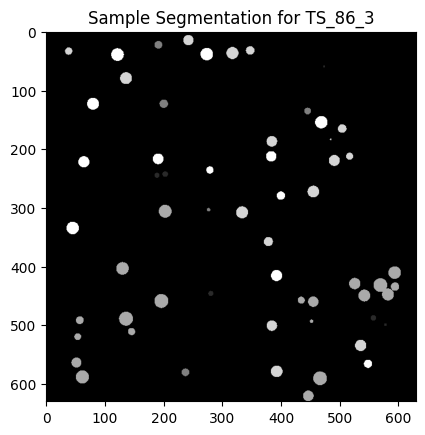

Processing Runs:  86%|████████▌ | 6/7 [00:06<00:01,  1.17s/run]

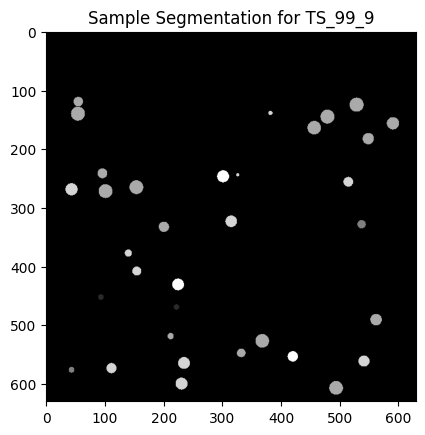

Processing Runs: 100%|██████████| 7/7 [00:08<00:00,  1.15s/run]


In [13]:
from tqdm import tqdm
import numpy as np
import logging
import matplotlib.pyplot as plt

# Configure logging
logging.basicConfig(level=logging.INFO, format="%(asctime)s - %(message)s")

# --- Data Loading ---
data_dicts = []

for run in tqdm(root.runs, desc="Processing Runs", unit="run"):
    try:
        tomograms = run.get_voxel_spacing(voxel_size).get_tomograms(tomo_type)
        if not tomograms:
            logging.warning(f"No tomograms found for run {run.name}")
            continue

        tomogram = tomograms[0].numpy()
        logging.info(f"Tomogram shape for {run.name}: {tomogram.shape}")

        segmentations = run.get_segmentations(
            name=copick_segmentation_name, user_id=copick_user_name,
            voxel_size=voxel_size, is_multilabel=True
        )
        if not segmentations:
            logging.warning(f"No segmentations found for {run.name}")
            continue

        segmentation = segmentations[0].numpy()
        if np.all(segmentation == 0):
            logging.warning(f"Segmentation for {run.name} is all zeros.")
            continue

        if segmentation.shape != tomogram.shape:
            logging.warning(f"Shape mismatch for {run.name}: "
                            f"tomogram {tomogram.shape}, segmentation {segmentation.shape}")
            continue

        # Optionally visualize
        plt.imshow(segmentation[segmentation.shape[0] // 2], cmap="gray")
        plt.title(f"Sample Segmentation for {run.name}")
        plt.show()

        data_dicts.append({"image": tomogram, "label": segmentation})
    except Exception as e:
        logging.error(f"Error processing run {run.name}: {e}")

if data_dicts:
    logging.info(f"Unique labels in the first segmentation: {np.unique(data_dicts[0]['label'])}")
else:
    logging.warning("No data collected from runs.")

In [14]:
for run in root.runs:
    for pickable_object in root.pickable_objects:
        if pickable_object.is_particle:
            picks = run.get_picks(object_name=pickable_object.name, user_id="curation")
            print(f"Run: {run.name}, Object: {pickable_object.name}, Number of picks: {len(picks)}")

Run: TS_5_4, Object: apo-ferritin, Number of picks: 1
Run: TS_5_4, Object: beta-galactosidase, Number of picks: 1
Run: TS_5_4, Object: ribosome, Number of picks: 1
Run: TS_5_4, Object: thyroglobulin, Number of picks: 1
Run: TS_5_4, Object: virus-like-particle, Number of picks: 1
Run: TS_69_2, Object: apo-ferritin, Number of picks: 1
Run: TS_69_2, Object: beta-galactosidase, Number of picks: 1
Run: TS_69_2, Object: ribosome, Number of picks: 1
Run: TS_69_2, Object: thyroglobulin, Number of picks: 1
Run: TS_69_2, Object: virus-like-particle, Number of picks: 1
Run: TS_6_4, Object: apo-ferritin, Number of picks: 1
Run: TS_6_4, Object: beta-galactosidase, Number of picks: 1
Run: TS_6_4, Object: ribosome, Number of picks: 1
Run: TS_6_4, Object: thyroglobulin, Number of picks: 1
Run: TS_6_4, Object: virus-like-particle, Number of picks: 1
Run: TS_6_6, Object: apo-ferritin, Number of picks: 1
Run: TS_6_6, Object: beta-galactosidase, Number of picks: 1
Run: TS_6_6, Object: ribosome, Number of 

## 4. Visualize the tomogram and painted segmentation from ground-truth picks

In [15]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Extract images and labels from data_dicts
images = data_dicts[0]['image']
labels = data_dicts[0]['label']

# Validate data shapes
assert images.shape[0] == labels.shape[0], "Mismatch in number of slices between images and labels!"

# Create a figure for animation
fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# Set up subplots
ax1, ax2 = axes
im1 = ax1.imshow(images[0], cmap='gray', interpolation='none')
ax1.set_title("Tomogram")
ax1.axis('off')

im2 = ax2.imshow(labels[0], cmap='viridis', interpolation='none')
ax2.set_title("Painted Segmentation from Picks")
ax2.axis('off')

# Add colorbars
fig.colorbar(im1, ax=ax1, orientation='vertical', label='Intensity')
fig.colorbar(im2, ax=ax2, orientation='vertical', label='Segmentation Labels')

# Update function for animation
def update(frame):
    im1.set_data(images[frame])
    im2.set_data(labels[frame])
    return [im1, im2]

# Sample every nth frame (optional)
n = 5
frames_to_display = range(0, len(images), n)

# Create the animation
ani = FuncAnimation(
    fig, update, frames=frames_to_display, interval=1000
)

# Display the animation
plt.close(fig)
HTML(ani.to_jshtml())

In [16]:
# import matplotlib.pyplot as plt
# from matplotlib.animation import FuncAnimation

# # Extract images and labels from data_dicts
# images = data_dicts[0]['image']
# labels = data_dicts[0]['label']

# # Create a figure for animation
# fig, axes = plt.subplots(1, 2, figsize=(15, 5))

# # Set up subplots
# ax1, ax2 = axes
# im1 = ax1.imshow(images[0], cmap='gray', interpolation='none')
# ax1.set_title("Tomogram")
# ax1.axis('off')

# im2 = ax2.imshow(labels[0], cmap='viridis', interpolation='none')
# ax2.set_title("Painted Segmentation from Picks")
# ax2.axis('off')

# # Update function for animation
# def update(frame):
#     im1.set_data(images[frame])
#     im2.set_data(labels[frame])
#     return [im1, im2]

# # Create the animation
# ani = FuncAnimation(
#     fig, update, frames=len(images), interval=10000  # 1 frame per second
# )

# # Display the animation
# plt.close(fig)  # Close the static figure to display animation only
# from IPython.display import HTML
# HTML(ani.to_jshtml())

## 5. Prepare dataloaders

In [17]:
import os
import numpy as np

total_size = 0
for run in root.runs:
    tomograms = run.get_voxel_spacing(10).get_tomograms(tomo_type)
    if tomograms:  # Check if there are any tomograms
        tomo = tomograms[0].numpy()  # Use the first tomogram if multiple are returned
        total_size += tomo.nbytes  # Assuming tomo is now a numpy array for size calculation
    else:
        print(f"No tomograms found for run {run.name}")

print(f"Total size of tomograms: {total_size / (1024 * 1024):.2f} MB")

Total size of tomograms: 1950.10 MB


Total size of tomograms: 1950.10 MB

Total number of voxels in the dataset: 511207200

In [18]:
total_picks = 0
num_runs_with_picks = 0  # Counter for runs with picks

for run in root.runs:
    has_picks = False  # Flag to check if the current run has any picks
    for pickable_object in root.pickable_objects:
        if pickable_object.is_particle:
            picks = run.get_picks(object_name=pickable_object.name, user_id="curation")
            if picks:
                total_picks += len(picks)
                has_picks = True
    if has_picks:
        num_runs_with_picks += 1

print(f"Total number of picks: {total_picks}")
print(f"Number of runs with picks: {num_runs_with_picks}")

num_runs = len(root.runs)
print(f"Number of runs or tomograms in the dataset: {num_runs}")

total_voxels = 0
missing_tomograms = []  # List to store runs with missing tomograms

for run in root.runs:
    tomogram_list = run.get_voxel_spacing(10).get_tomograms(tomo_type)
    if tomogram_list:
        for tomogram in tomogram_list:
            tomo_numpy = tomogram.numpy()
            total_voxels += tomo_numpy.size
    else:
        missing_tomograms.append(run.name)
        print(f"No tomograms found for run {run.name}")

print(f"Total number of voxels in the dataset: {total_voxels}")

if missing_tomograms:
    print(f"Runs with missing tomograms: {', '.join(missing_tomograms)}")

Total number of picks: 35
Number of runs with picks: 7
Number of runs or tomograms in the dataset: 7
Total number of voxels in the dataset: 511207200


In [19]:
# Modularize Transforms
def get_non_random_transforms():
    return Compose([
        EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
        NormalizeIntensityd(keys="image"),
        Orientationd(keys=["image", "label"], axcodes="RAS")
    ])

def get_random_transforms(spatial_size, num_classes, num_samples):
    return Compose([
        RandCropByLabelClassesd(
            keys=["image", "label"],
            label_key="label",
            spatial_size=spatial_size,
            num_classes=num_classes,
            num_samples=num_samples
        ),
        RandRotate90d(keys=["image", "label"], prob=0.5, spatial_axes=[0, 2]),
        RandFlipd(keys=["image", "label"], prob=0.5, spatial_axis=0),
    ])

In [20]:
# Modularize Dataset Creation
def create_dataset(data_files, non_random_transforms, random_transforms, cache_rate=1.0):
    cached_ds = CacheDataset(data=data_files, transform=non_random_transforms, cache_rate=cache_rate)
    return Dataset(data=cached_ds, transform=random_transforms)

In [21]:
# Parameterize Dataset Splits
def split_dataset(data_dicts, train_ratio=0.7):
    split_index = int(len(data_dicts) * train_ratio)
    return data_dicts[:split_index], data_dicts[split_index:]

In [22]:
# Create a Utility for DataLoader
def create_dataloader(dataset, batch_size, shuffle, num_workers=4):
    return DataLoader(
        dataset,
        batch_size=batch_size,
        shuffle=shuffle,
        num_workers=num_workers,
        pin_memory=torch.cuda.is_available()
    )

In [23]:
import warnings
from monai.transforms import (
    Compose, EnsureChannelFirstd, NormalizeIntensityd, Orientationd, RandCropByLabelClassesd,
    RandRotate90d, RandFlipd
)
from monai.data import CacheDataset, Dataset, DataLoader
import torch

warnings.filterwarnings("ignore")

# Parameters
my_num_samples = 16
train_batch_size = 1
val_batch_size = 1
img_size = [96, 96, 96]
num_classes = len(root.pickable_objects) + 1  # +1 for background class

# Split dataset
train_files, val_files = split_dataset(data_dicts, train_ratio=0.7)
print(f"Number of training samples: {len(train_files)}")
print(f"Number of validation samples: {len(val_files)}")

# Transforms
non_random_transforms = get_non_random_transforms()
random_transforms = get_random_transforms(img_size, num_classes, my_num_samples)

# Create datasets
train_ds = create_dataset(train_files, non_random_transforms, random_transforms)
val_ds = create_dataset(val_files, non_random_transforms, random_transforms)

# Create DataLoaders
train_loader = create_dataloader(train_ds, train_batch_size, shuffle=True)
val_loader = create_dataloader(val_ds, val_batch_size, shuffle=False)

# Optional: Quick check of data shapes
for batch in train_loader:
    print("Training - Image shape:", batch["image"].shape)
    print("Training - Label shape:", batch["label"].shape)
    break

for batch in val_loader:
    print("Validation - Image shape:", batch["image"].shape)
    print("Validation - Label shape:", batch["label"].shape)
    break

Number of training samples: 4
Number of validation samples: 3


Loading dataset: 100%|██████████| 3/3 [00:01<00:00,  2.26it/s]


Training - Image shape: torch.Size([16, 1, 96, 96, 96])
Training - Label shape: torch.Size([16, 1, 96, 96, 96])
Validation - Image shape: torch.Size([16, 1, 96, 96, 96])
Validation - Label shape: torch.Size([16, 1, 96, 96, 96])


In [24]:
# ## using subset of the original dataset

# import warnings
# warnings.filterwarnings("ignore")

# my_num_samples = 16
# train_batch_size = 1
# val_batch_size = 1
# img_size= 96
# num_classes = len(root.pickable_objects) + 1  # +1 for background class

# train_files, val_files = data_dicts[:5], data_dicts[5:7]
# print(f"Number of training samples: {len(train_files)}")
# print(f"Number of validation samples: {len(val_files)}")

# # Non-random transforms to be cached
# non_random_transforms = Compose([
#     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
#     NormalizeIntensityd(keys="image"),
#     Orientationd(keys=["image", "label"], axcodes="RAS")
# ])

# # Random transforms to be applied during training
# random_transforms = Compose([
#     RandCropByLabelClassesd(
#         keys=["image", "label"],
#         label_key="label",
#         spatial_size=[96, 96, 96], 
#         num_classes=num_classes,
#         num_samples=my_num_samples
#     ),
#     RandRotate90d(keys=["image", "label"], prob=0.5, spatial_axes=[0, 2]),
#     RandFlipd(keys=["image", "label"], prob=0.5, spatial_axis=0),    
# ])

# # Create the cached dataset with non-random transforms
# train_ds = CacheDataset(data=train_files, transform=non_random_transforms, cache_rate=1.0)

# # Wrap the cached dataset to apply random transforms during iteration
# train_ds = Dataset(data=train_ds, transform=random_transforms)

# # DataLoader remains the same
# train_loader = DataLoader(
#     train_ds,
#     batch_size=train_batch_size,
#     shuffle=True,
#     num_workers=4,
#     pin_memory=torch.cuda.is_available()
# )

# # Validation transforms
# val_transforms = Compose([
#     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
#     NormalizeIntensityd(keys="image"),
#     RandCropByLabelClassesd(
#         keys=["image", "label"],
#         label_key="label",
#         spatial_size=[96, 96, 96],
#         num_classes=num_classes,
#         num_samples=my_num_samples,  # Use 1 to get a single, consistent crop per image
#     ),
# ])

# # Create validation dataset
# val_ds = CacheDataset(data=val_files, transform=non_random_transforms, cache_rate=1.0)

# # Wrap the cached dataset to apply random transforms during iteration
# val_ds = Dataset(data=val_ds, transform=random_transforms)

# # Create validation DataLoader
# val_loader = DataLoader(
#     val_ds,
#     batch_size=val_batch_size,
#     num_workers=4,
#     pin_memory=torch.cuda.is_available(),
#     shuffle=False,  # Ensure the data order remains consistent
# )

# # Optional: Quick check of data shapes
# for batch in train_loader:
#     print("Training - Image shape:", batch["image"].shape)
#     print("Training - Label shape:", batch["label"].shape)
#     break

# for batch in val_loader:
#     print("Validation - Image shape:", batch["image"].shape)
#     print("Validation - Label shape:", batch["label"].shape)
#     break

Size of Tensor of DataSets 
* Training - Image shape: torch.Size([16, 1, 96, 96, 96])
* Training - Label shape: torch.Size([16, 1, 96, 96, 96])
* Validation - Image shape: torch.Size([16, 1, 96, 96, 96])
* Validation - Label shape: torch.Size([16, 1, 96, 96, 96])

***This code is suppose to work***

In [25]:
# import torch
# import torch.nn.functional as F
# from torch import nn
# import numpy as np
# from tqdm import tqdm
# import time
# import mlflow
# from torchinfo import summary
# from monai.losses import FocalLoss
# from monai.metrics import FBetaScore
# from torch.optim.lr_scheduler import ReduceLROnPlateau
# from monai.data import decollate_batch, CacheDataset, Dataset, DataLoader
# from monai.transforms import (
#     AsDiscrete, Compose, EnsureChannelFirstd, Orientationd, NormalizeIntensityd, RandFlipd, RandRotate90d, RandCropByLabelClassesd, LoadImaged
# )
# import os
# from monai.networks.nets import UNet

# # --- Device Configuration ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# # --- ManualWeightedFocalLoss ---
# class ManualWeightedFocalLoss(FocalLoss):
#     def __init__(self, alpha=None, gamma=2.0, reduction='mean'):
#         super().__init__(gamma=gamma, reduction=reduction)
#         self.alpha = torch.tensor(alpha).float()

#     def forward(self, input, target):
#         focal_loss = super().forward(input, target)

#         if self.alpha.device != input.device:
#             self.alpha = self.alpha.to(input.device)

#         # target is expected to be one-hot encoded at this point
#         weights = torch.sum(self.alpha * target, dim=1)
#         weighted_focal_loss = weights * focal_loss

#         if self.reduction == 'mean':
#             return torch.mean(weighted_focal_loss)
#         elif self.reduction == 'sum':
#             return torch.sum(weighted_focal_loss)
#         else:  # 'none'
#             return weighted_focal_loss

# # --- F4 Score ---
# class F4Score:
#     def __init__(self, beta=4):
#         self.beta = beta
#         self.fbeta_score = FBetaScore(beta=beta, average='micro', num_classes=num_classes, ignore_empty=True)

#     def __call__(self, outputs, targets):
#         # Assuming outputs are logits, apply sigmoid to get probabilities
#         outputs = torch.sigmoid(outputs)
        
#         # Apply post-processing to make outputs and targets one-hot
#         outputs_one_hot = [post_pred(i) for i in decollate_batch(outputs)]
#         targets_one_hot = [post_label(i) for i in decollate_batch(targets)]

#         # Convert to tensors.
#         outputs_one_hot = torch.stack(outputs_one_hot)
#         targets_one_hot = torch.stack(targets_one_hot)
        
#         # Calculate F4 score for each class and then average across batches and classes.
#         f4_scores = []
#         for cls in range(outputs.shape[1]):  # Iterate over classes.
#             TP = (outputs_one_hot[:, cls] * targets_one_hot[:, cls]).sum().float()
#             FP = ((1 - targets_one_hot[:, cls]) * outputs_one_hot[:, cls]).sum().float()
#             FN = (targets_one_hot[:, cls] * (1 - outputs_one_hot[:, cls])).sum().float()

#             precision = TP / (TP + FP + 1e-7)
#             recall = TP / (TP + FN + 1e-7)
#             f4 = (1 + self.beta**2) * (precision * recall) / (self.beta**2 * precision + recall + 1e-7)
#             f4_scores.append(f4)

#         # Average F4 score across classes
#         f4_mean = torch.mean(torch.tensor(f4_scores))
#         return f4_mean.item()

#     def reset(self):
#         self.fbeta_score.reset()

# # --- Data Transforms ---
# my_num_samples = 1
# train_batch_size = 2
# val_batch_size = 2

# train_files, val_files = data_dicts[:5], data_dicts[5:7]
# print(f"Number of training samples: {len(train_files)}")
# print(f"Number of validation samples: {len(val_files)}")

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # --- Custom Transform to Apply AsDiscrete to Label ---
# class ApplyAsDiscreteToLabeld(MapTransform):
#     def __init__(self, keys, to_onehot):
#         super().__init__(keys)
#         self.to_onehot = to_onehot

#     def __call__(self, data):
#         d = dict(data)
#         d["label"] = AsDiscrete(to_onehot=self.to_onehot)(d["label"])
#         return d

# # Transforms
# train_transforms = Compose([
#     LoadImaged(keys=["image", "label"]),
#     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
#     NormalizeIntensityd(keys="image"),
#     Orientationd(keys=["image", "label"], axcodes="RAS"),
#     AsDiscrete(keys="label", to_onehot=num_classes),
#     RandCropByLabelClassesd(
#         keys=["image", "label"],
#         label_key="label",
#         spatial_size=[96, 96, 96],
#         num_classes=num_classes,
#         num_samples=my_num_samples,
#         allow_missing_classes=True
#     ),
#     RandRotate90d(keys=["image", "label"], prob=0.5, spatial_axes=[0, 2]),
#     RandFlipd(keys=["image", "label"], prob=0.5, spatial_axis=0),
# ])

# val_transforms = Compose([
#     LoadImaged(keys=["image", "label"]),
#     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
#     NormalizeIntensityd(keys="image"),
#     Orientationd(keys=["image", "label"], axcodes="RAS"),
#     AsDiscrete(keys="label", to_onehot=num_classes),
#     RandCropByLabelClassesd(
#         keys=["image", "label"],
#         label_key="label",
#         spatial_size=[96, 96, 96],
#         num_classes=num_classes,
#         num_samples=my_num_samples,
#         allow_missing_classes=True
#     ),
# ])

# # Create the training dataset
# train_ds = CacheDataset(data=train_files, transform=train_transforms, cache_rate=1.0)
# train_loader = DataLoader(train_ds, batch_size=train_batch_size, shuffle=True, num_workers=4, pin_memory=torch.cuda.is_available())

# # Create the validation dataset
# val_ds = CacheDataset(data=val_files, transform=val_transforms, cache_rate=1.0)
# val_loader = DataLoader(val_ds, batch_size=val_batch_size, num_workers=2, pin_memory=torch.cuda.is_available(), shuffle=False)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model-60-pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     state_dict = torch.load(pretrained_weights_path, map_location=device)

#     # Remove unexpected keys from the state_dict
#     unexpected_keys = ['model.0.conv.unit0.conv.weight', 'model.0.conv.unit0.conv.bias', 'model.0.conv.unit2.conv.weight', 'model.0.conv.unit2.conv.bias', 'model.0.conv.unit0.norm.weight', 'model.0.conv.unit0.norm.bias', 'model.0.conv.unit2.norm.weight', 'model.0.conv.unit2.norm.bias', 'model.10.conv.weight', 'model.10.conv.bias']
#     for key in unexpected_keys:
#         state_dict.pop(key, None)

#     # Load the state_dict into the model
#     model.load_state_dict(state_dict, strict=False)
#     print(f"Loaded pre-trained weights from: {pretrained_weights_path}")

#     # --- Transfer Learning: Freeze Most Layers ---
#     # Freeze all layers except the last convolutional layer
#     for name, param in model.named_parameters():
#         if not "model.9.conv" in name:  # Unfreeze only the last convolutional layer
#             param.requires_grad = False

#     # --- Check requires_grad after Freezing ---
#     print("\nChecking requires_grad after freezing layers:")
#     for name, param in model.named_parameters():
#         print(f"Layer: {name}, Trainable: {param.requires_grad}")

#     # --- Reinitialize Optimizer ---
#     optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, weight_decay=1e-5)
#     print("Optimizer reinitialized after freezing layers.")

# else:
#     print(f"Error: Pre-trained weights file not found at: {pretrained_weights_path}")

# # --- Loss Function, Metrics, etc. ---
# # --- Optimizer ---
# lr = 1e-3
# optimizer = AdamW(model.parameters(), lr=lr)  # Use AdamW here
# print(f"Optimizer: AdamW, Learning Rate: {lr}")

# # --- Define Class Weights (alpha) ---
# # Assuming 'weights' dictionary and 'class_order' list are defined as before
# weights = {
#     'apo-ferritin': 1,
#     'beta-galactosidase': 2,
#     'ribosome': 1,
#     'thyroglobulin': 2,
#     'virus-like-particle': 1,
# }
# class_order = ['background', 'apo-ferritin', 'beta-galactosidase', 'ribosome', 'thyroglobulin', 'virus-like-particle']
# alpha = [0] + [weights.get(particle_type, 0) for particle_type in class_order[1:]]
# alpha = torch.tensor(alpha).float().to(device)

# # --- Loss Function ---
# loss_function = ManualWeightedFocalLoss(alpha=alpha, gamma=gamma)
# print(f"Loss Function: ManualWeightedFocalLoss with alpha={alpha.tolist()}")

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=False, reduction="mean", ignore_empty=True)
# recall_metric = ConfusionMatrixMetric(include_background=False, metric_name="recall", reduction="None")
# print(f"Metrics: Dice, Recall (per class)")

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Function ---
# post_pred = AsDiscrete(argmax=True, to_onehot=num_classes)
# post_label = AsDiscrete(to_onehot=num_classes)

# def train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=100, val_interval=2):
#     best_metric = -1
#     best_metric_epoch = -1
#     epoch_loss_values = []
#     metric_values = []

#     for epoch in range(max_epochs):
#         print("-" * 10)
#         print(f"epoch {epoch + 1}/{max_epochs}")
#         model.train()
#         epoch_loss = 0
#         epoch_metric = 0
#         start_time = time.time()

#         with tqdm(total=len(train_loader), desc=f"Epoch {epoch + 1}/{max_epochs}", unit="batch") as progress_bar:
#             for batch_idx, batch_data in enumerate(train_loader, 1):
#                 inputs, labels = batch_data["image"].to(device), batch_data["label"].to(device)
#                 optimizer.zero_grad()
#                 outputs = model(inputs)
#                 loss = loss_function(outputs, labels)
#                 loss.backward()
#                 optimizer.step()

#                 epoch_loss += loss.item()
#                 metric = metric_function(outputs, labels)
#                 epoch_metric += metric

#                 progress_bar.set_postfix({"loss": loss.item(), "metric": metric})
#                 progress_bar.update()

#         epoch_loss /= len(train_loader)
#         epoch_metric /= len(train_loader)
#         epoch_loss_values.append(epoch_loss)
#         print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")
#         mlflow.log_metric("train_loss", epoch_loss, step=epoch+1)
#         mlflow.log_metric("train_metric", epoch_metric, step=epoch)

#         if (epoch + 1) % val_interval == 0:
#             model.eval()
#             with torch.no_grad():
#                 for val_data in val_loader:
#                     val_inputs, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#                     val_outputs = model(val_inputs)

#                     val_outputs_one_hot = [post_pred(i) for i in decollate_batch(val_outputs)]
#                     val_labels_one_hot = [post_label(i) for i in decollate_batch(val_labels)]

#                     metric_function(y_pred=val_outputs_one_hot, y=val_labels_one_hot)

#                 metrics = metric_function.aggregate().cpu()
#                 mean_metric = np.mean(metrics)
#                 mlflow.log_metric("validation_metric", mean_metric, step=epoch+1)
#                 metric_function.reset()

#                 metric_values.append(mean_metric)
#                 if mean_metric > best_metric:
#                     best_metric = mean_metric
#                     best_metric_epoch = epoch + 1
#                     torch.save(model.state_dict(), os.path.join('./', "best_metric_model.pth"))
#                     print("Saved new best metric model")
#                 print(
#                     f"current epoch: {epoch + 1} current mean metric: {mean_metric}"
#                     f"\nbest mean metric: {best_metric:.4f} at epoch: {best_metric_epoch}"
#                 )

#         end_time = time.time()
#         epoch_time = end_time - start_time
#         print(f"Epoch time: {end_time - start_time:.2f} seconds")
#         mlflow.log_metric("epoch_time", epoch_time, step=epoch)

# # --- Hyperparameters ---
# lr = 0.0001
# gamma = 2
# epochs = 50

# # --- Summary ---
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# summary_str = str(model_summary)
# with open("model_summary.txt", "w") as f:
#     f.write(summary_str)

# # --- Main Training Loop ---
# mlflow.end_run()
# mlflow.set_experiment('training 3D U-Net model for the cryoET ML Challenge')

# with mlflow.start_run():
#     params = {
#         "epochs": epochs,
#         "learning_rate": lr,
#         "loss_function": loss_function.__class__.__name__,
#         "metric_function": metric_function.__class__.__name__,
#         "optimizer": "AdamW",
#         "gamma": gamma,
#     }
#     mlflow.log_params(params)

#     mlflow.log_artifact("model_summary.txt")

#     train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=epochs, val_interval=2)

#     mlflow.pytorch.log_model(model, "model")

In [26]:
# import torch
# import torch.nn.functional as F
# from torch import nn
# import numpy as np
# from tqdm import tqdm
# import time
# import mlflow
# from torchinfo import summary
# from monai.losses import FocalLoss
# from monai.metrics import FBetaScore
# from torch.optim.lr_scheduler import ReduceLROnPlateau
# from monai.data import decollate_batch, CacheDataset, Dataset, DataLoader
# from monai.transforms import (
#     AsDiscrete, Compose, EnsureChannelFirstd, Orientationd, NormalizeIntensityd, RandFlipd, RandRotate90d, RandCropByLabelClassesd, LoadImaged
# )
# import os
# from monai.networks.nets import UNet

# # --- Device Configuration ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# # --- ManualWeightedFocalLoss ---
# class ManualWeightedFocalLoss(FocalLoss):
#     def __init__(self, alpha=None, gamma=2.0, reduction='mean'):
#         super().__init__(gamma=gamma, reduction=reduction)
#         self.alpha = torch.tensor(alpha).float()

#     def forward(self, input, target):
#         focal_loss = super().forward(input, target)

#         if self.alpha.device != input.device:
#             self.alpha = self.alpha.to(input.device)

#         # target is expected to be one-hot encoded at this point
#         weights = torch.sum(self.alpha * target, dim=1)
#         weighted_focal_loss = weights * focal_loss

#         if self.reduction == 'mean':
#             return torch.mean(weighted_focal_loss)
#         elif self.reduction == 'sum':
#             return torch.sum(weighted_focal_loss)
#         else:  # 'none'
#             return weighted_focal_loss

# # --- F4 Score ---
# class F4Score:
#     def __init__(self, beta=4):
#         self.beta = beta
#         self.fbeta_score = FBetaScore(beta=beta, average='micro', num_classes=num_classes, ignore_empty=True)

#     def __call__(self, outputs, targets):
#         # Assuming outputs are logits, apply sigmoid to get probabilities
#         outputs = torch.sigmoid(outputs)
        
#         # Apply post-processing to make outputs and targets one-hot
#         outputs_one_hot = [post_pred(i) for i in decollate_batch(outputs)]
#         targets_one_hot = [post_label(i) for i in decollate_batch(targets)]

#         # Convert to tensors.
#         outputs_one_hot = torch.stack(outputs_one_hot)
#         targets_one_hot = torch.stack(targets_one_hot)
        
#         # Calculate F4 score for each class and then average across batches and classes.
#         f4_scores = []
#         for cls in range(outputs.shape[1]):  # Iterate over classes.
#             TP = (outputs_one_hot[:, cls] * targets_one_hot[:, cls]).sum().float()
#             FP = ((1 - targets_one_hot[:, cls]) * outputs_one_hot[:, cls]).sum().float()
#             FN = (targets_one_hot[:, cls] * (1 - outputs_one_hot[:, cls])).sum().float()

#             precision = TP / (TP + FP + 1e-7)
#             recall = TP / (TP + FN + 1e-7)
#             f4 = (1 + self.beta**2) * (precision * recall) / (self.beta**2 * precision + recall + 1e-7)
#             f4_scores.append(f4)

#         # Average F4 score across classes
#         f4_mean = torch.mean(torch.tensor(f4_scores))
#         return f4_mean.item()

#     def reset(self):
#         self.fbeta_score.reset()

# # --- Data Transforms ---
# my_num_samples = 1
# train_batch_size = 2
# val_batch_size = 2

# train_files, val_files = data_dicts[:5], data_dicts[5:7]
# print(f"Number of training samples: {len(train_files)}")
# print(f"Number of validation samples: {len(val_files)}")

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # --- Custom Transform to Apply AsDiscrete to Label ---
# class ApplyAsDiscreteToLabeld(MapTransform):
#     def __init__(self, keys, to_onehot):
#         super().__init__(keys)
#         self.to_onehot = to_onehot

#     def __call__(self, data):
#         d = dict(data)
#         d["label"] = AsDiscrete(to_onehot=self.to_onehot)(d["label"])
#         return d

# non_random_transforms = Compose([
#     LoadImaged(keys=["image", "label"]),
#     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
#     NormalizeIntensityd(keys="image"),
#     Orientationd(keys=["image", "label"], axcodes="RAS"),
#     ApplyAsDiscreteToLabeld(keys="label", to_onehot=num_classes)
# ])

# random_transforms = Compose([
#     RandCropByLabelClassesd(
#         keys=["image", "label"],
#         label_key="label",
#         spatial_size=[96, 96, 96],
#         num_classes=num_classes,
#         num_samples=my_num_samples
#     ),
#     RandRotate90d(keys=["image", "label"], prob=0.5, spatial_axes=[0, 2]),
#     RandFlipd(keys=["image", "label"], prob=0.5, spatial_axis=0),
# ])

# val_transforms = Compose([
#     LoadImaged(keys=["image", "label"]),
#     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
#     NormalizeIntensityd(keys="image"),
#     Orientationd(keys=["image", "label"], axcodes="RAS"),
#     AsDiscrete(keys="label", to_onehot=num_classes),
#     RandCropByLabelClassesd(
#         keys=["image", "label"],
#         label_key="label",
#         spatial_size=[96, 96, 96],
#         num_classes=num_classes,
#         num_samples=my_num_samples
#     )
# ])

# # Create the training dataset with data augmentation
# train_ds = CacheDataset(data=train_files, transform=Compose([non_random_transforms, random_transforms]), cache_rate=1.0)
# train_loader = DataLoader(train_ds, batch_size=train_batch_size, shuffle=True, num_workers=4, pin_memory=torch.cuda.is_available())

# # Create the validation dataset without data augmentation
# val_ds = CacheDataset(data=val_files, transform=val_transforms, cache_rate=1.0)
# val_loader = DataLoader(val_ds, batch_size=val_batch_size, num_workers=2, pin_memory=torch.cuda.is_available(), shuffle=False)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model-60-pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     state_dict = torch.load(pretrained_weights_path, map_location=device)

#     # Remove unexpected keys from the state_dict
#     unexpected_keys = ['model.0.conv.unit0.conv.weight', 'model.0.conv.unit0.conv.bias', 'model.0.conv.unit2.conv.weight', 'model.0.conv.unit2.conv.bias', 'model.0.conv.unit0.norm.weight', 'model.0.conv.unit0.norm.bias', 'model.0.conv.unit2.norm.weight', 'model.0.conv.unit2.norm.bias', 'model.10.conv.weight', 'model.10.conv.bias']
#     for key in unexpected_keys:
#         state_dict.pop(key, None)

#     # Load the state_dict into the model
#     model.load_state_dict(state_dict, strict=False)
#     print(f"Loaded pre-trained weights from: {pretrained_weights_path}")

#     # --- Transfer Learning: Freeze Most Layers ---
#     # Freeze all layers except the last convolutional layer
#     for name, param in model.named_parameters():
#         if not "model.9.conv" in name:  # Unfreeze only the last convolutional layer
#             param.requires_grad = False

#     # --- Check requires_grad after Freezing ---
#     print("\nChecking requires_grad after freezing layers:")
#     for name, param in model.named_parameters():
#         print(f"Layer: {name}, Trainable: {param.requires_grad}")

#     # --- Reinitialize Optimizer ---
#     optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, weight_decay=1e-5)
#     print("Optimizer reinitialized after freezing layers.")

# else:
#     print(f"Error: Pre-trained weights file not found at: {pretrained_weights_path}")

# # --- Loss Function, Metrics, etc. ---
# # --- Optimizer ---
# lr = 1e-3
# optimizer = AdamW(model.parameters(), lr=lr)  # Use AdamW here
# print(f"Optimizer: AdamW, Learning Rate: {lr}")

# # --- Define Class Weights (alpha) ---
# # Assuming 'weights' dictionary and 'class_order' list are defined as before
# # --- Define Class Weights (alpha) ---
# weights = {
#     'apo-ferritin': 1,
#     'beta-galactosidase': 2,
#     'ribosome': 1,
#     'thyroglobulin': 2,
#     'virus-like-particle': 1,
# }
# class_order = ['apo-ferritin', 'beta-galactosidase', 'ribosome', 'thyroglobulin', 'virus-like-particle', 'background']
# # Note: 'membrane' is not included in class_order

# alpha = [weights.get(particle_type, 0) for particle_type in class_order]
# alpha = torch.tensor(alpha, device=device).float().clone().detach()

# # --- Loss Function ---
# loss_function = ManualWeightedFocalLoss(alpha=alpha, gamma=gamma)
# print(f"Loss Function: ManualWeightedFocalLoss with alpha={alpha.tolist()}")

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=False, reduction="mean", ignore_empty=True)
# recall_metric = ConfusionMatrixMetric(include_background=False, metric_name="recall", reduction="None")
# print(f"Metrics: Dice, Recall (per class)")

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Function ---
# post_pred = AsDiscrete(argmax=True, to_onehot=num_classes)
# post_label = AsDiscrete(to_onehot=num_classes)

# def train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=100, val_interval=2):
#     best_metric = -1
#     best_metric_epoch = -1
#     epoch_loss_values = []
#     metric_values = []

#     for epoch in range(max_epochs):
#         print("-" * 10)
#         print(f"epoch {epoch + 1}/{max_epochs}")
#         model.train()
#         epoch_loss = 0
#         epoch_metric = 0
#         start_time = time.time()

#         with tqdm(total=len(train_loader), desc=f"Epoch {epoch + 1}/{max_epochs}", unit="batch") as progress_bar:
#             for batch_idx, batch_data in enumerate(train_loader, 1):
#                 inputs, labels = batch_data["image"].to(device), batch_data["label"].to(device)
#                 optimizer.zero_grad()
#                 outputs = model(inputs)
#                 loss = loss_function(outputs, labels)
#                 loss.backward()
#                 optimizer.step()

#                 epoch_loss += loss.item()
#                 metric = metric_function(outputs, labels)
#                 epoch_metric += metric

#                 progress_bar.set_postfix({"loss": loss.item(), "metric": metric})
#                 progress_bar.update()

#         epoch_loss /= len(train_loader)
#         epoch_metric /= len(train_loader)
#         epoch_loss_values.append(epoch_loss)
#         print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")
#         mlflow.log_metric("train_loss", epoch_loss, step=epoch+1)
#         mlflow.log_metric("train_metric", epoch_metric, step=epoch)

#         if (epoch + 1) % val_interval == 0:
#             model.eval()
#             with torch.no_grad():
#                 for val_data in val_loader:
#                     val_inputs, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#                     val_outputs = model(val_inputs)

#                     val_outputs_one_hot = [post_pred(i) for i in decollate_batch(val_outputs)]
#                     val_labels_one_hot = [post_label(i) for i in decollate_batch(val_labels)]

#                     metric_function(y_pred=val_outputs_one_hot, y=val_labels_one_hot)

#                 metrics = metric_function.aggregate().cpu()
#                 mean_metric = np.mean(metrics)
#                 mlflow.log_metric("validation_metric", mean_metric, step=epoch+1)
#                 metric_function.reset()

#                 metric_values.append(mean_metric)
#                 if mean_metric > best_metric:
#                     best_metric = mean_metric
#                     best_metric_epoch = epoch + 1
#                     torch.save(model.state_dict(), os.path.join('./', "best_metric_model.pth"))
#                     print("Saved new best metric model")
#                 print(
#                     f"current epoch: {epoch + 1} current mean metric: {mean_metric}"
#                     f"\nbest mean metric: {best_metric:.4f} at epoch: {best_metric_epoch}"
#                 )

#         end_time = time.time()
#         epoch_time = end_time - start_time
#         print(f"Epoch time: {end_time - start_time:.2f} seconds")
#         mlflow.log_metric("epoch_time", epoch_time, step=epoch)

# # --- Hyperparameters ---
# lr = 0.0001
# gamma = 2
# epochs = 50

# # --- Summary ---
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# summary_str = str(model_summary)
# with open("model_summary.txt", "w") as f:
#     f.write(summary_str)

# # --- Main Training Loop ---
# mlflow.end_run()
# mlflow.set_experiment('training 3D U-Net model for the cryoET ML Challenge')

# with mlflow.start_run():
#     params = {
#         "epochs": epochs,
#         "learning_rate": lr,
#         "loss_function": loss_function.__class__.__name__,
#         "metric_function": metric_function.__class__.__name__,
#         "optimizer": "AdamW",
#         "gamma": gamma,
#     }
#     mlflow.log_params(params)

#     mlflow.log_artifact("model_summary.txt")

#     train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=epochs, val_interval=2)

#     mlflow.pytorch.log_model(model, "model")

## 6. Model setup

**ManualWeightedFocalLoss Module**

In [27]:
%%file loss.py

import torch
import torch.nn.functional as F

class ManualWeightedFocalLoss(nn.Module):
    def __init__(self, alpha=None, gamma=2, reduction='mean'):
        """
        alpha: Tensor of class weights (size: num_classes) or None for equal weighting.
        gamma: Focusing parameter for Focal Loss.
        reduction: Specifies the reduction to apply to the output ('none', 'mean', 'sum').
        """
        super(ManualWeightedFocalLoss, self).__init__()
        self.alpha = alpha if alpha is not None else None  # Tensor of weights for each class
        self.gamma = gamma
        self.reduction = reduction

    def forward(self, inputs, targets):
        """
        inputs: Predicted logits (shape: [batch_size, num_classes, depth, height, width]).
        targets: Ground truth labels (shape: [batch_size, depth, height, width]).
        """
        # If targets is a MONAI MetaTensor, extract the tensor part
        if hasattr(targets, 'tensor'):
            targets = targets.tensor  # Strip metadata
        
        # Ensure targets are integers (class indices)
        targets = targets.long()  # Convert targets to long type if necessary
        
        # Flatten the input tensors to match the expected shape for focal loss
        batch_size, num_channels, *spatial_dims = inputs.shape
        inputs = inputs.view(batch_size, num_channels, -1)  # Flatten spatial dimensions
        targets = targets.view(batch_size, -1)  # Flatten target to match

        # Convert targets to one-hot encoding
        targets_one_hot = F.one_hot(targets, num_classes=num_channels).permute(0, 2, 1).float()

        # Apply softmax to inputs to get probabilities
        probs = F.softmax(inputs, dim=1)
        
        # Gather probabilities corresponding to the true class
        probs_true_class = (probs * targets_one_hot).sum(dim=1)

        # Compute the focal loss factor
        focal_factor = (1 - probs_true_class) ** self.gamma

        # Compute log probabilities for the true class
        log_probs_true_class = torch.log(probs_true_class + 1e-8)

        # Compute raw focal loss
        raw_loss = -focal_factor * log_probs_true_class

        # Apply class weights (alpha) if provided
        if self.alpha is not None:
            if self.alpha.shape[0] != num_channels:
                raise ValueError(f"Alpha must have the same number of elements as the number of classes: {num_channels}")
            alpha_factor = self.alpha[targets]
            raw_loss = raw_loss * alpha_factor

        # Apply reduction
        if self.reduction == 'mean':
            return raw_loss.mean()
        elif self.reduction == 'sum':
            return raw_loss.sum()
        else:  # 'none'
            return raw_loss

Writing loss.py


In [28]:
# !cat loss.py

In [29]:
# %%file loss.py
# import torch

# class ManualWeightedFocalLoss(torch.nn.Module):
#     def __init__(self, weight=None, gamma=2, alpha=0.25, reduction="mean"):
#         """
#         Initialize the ManualWeightedFocalLoss class.

#         :param weight: Tensor of class weights.
#         :param gamma: Focusing parameter for the focal loss.
#         :param alpha: Balancing factor for positive/negative class.
#         :param reduction: Type of reduction to apply. Can be 'mean', 'sum', or 'none'.
#         """
#         super(ManualWeightedFocalLoss, self).__init__()
#         self.gamma = gamma
#         self.alpha = alpha
#         self.reduction = reduction
#         self.weight = weight

#     def forward(self, inputs, targets):
#         """
#         Compute the focal loss.

#         :param inputs: The model outputs (logits).
#         :param targets: The true labels (one-hot encoded).
#         :return: The computed focal loss.
#         """
#         # Apply sigmoid to get probabilities
#         inputs = torch.sigmoid(inputs)

#         # Flatten the input and target tensors
#         inputs = inputs.view(-1)
#         targets = targets.view(-1)

#         # Calculate focal loss components
#         ce_loss = - (self.alpha * (1 - inputs) ** self.gamma * targets * torch.log(inputs) +
#                      (1 - self.alpha) * inputs ** self.gamma * (1 - targets) * torch.log(1 - inputs))

#         # Apply the class weights (if provided)
#         if self.weight is not None:
#             ce_loss = ce_loss * self.weight

#         # Reduce loss
#         if self.reduction == "mean":
#             return ce_loss.mean()
#         elif self.reduction == "sum":
#             return ce_loss.sum()
#         else:
#             return ce_loss

**F4 Metric Module**

In [30]:
%%file metrics.py

# metrics.py
import torch
from monai.metrics import FBetaScore
from typing import List

class F4Score:
    def __init__(self, beta: int = 4, device: str = 'cuda'):
        """
        Initialize the F4Score class.

        :param beta: The beta value for the F-Score. Default is 4.
        :param device: The device to use for computations (e.g., 'cuda').
        """
        self.beta = beta
        self.device = device
        self.fbeta_score = FBetaScore(beta=beta, reduction="mean")  # MONAI metric

    def __call__(self, outputs: torch.Tensor, targets: torch.Tensor) -> float:
        """
        Compute the F4 score.

        :param outputs: The model outputs (logits) with shape [batch_size, num_classes].
        :param targets: The true labels (one-hot encoded) with shape [batch_size, num_classes].
        :return: The computed F4 score as a float.
        """
        # Ensure outputs and targets are on the correct device
        outputs = outputs.to(self.device)
        targets = targets.to(self.device)

        # Apply sigmoid to logits to obtain probabilities
        outputs = torch.sigmoid(outputs)

        # Decollate and process batch predictions and labels
        outputs_one_hot = [self.post_pred(i) for i in self.decollate_batch(outputs)]
        targets_one_hot = [self.post_label(i) for i in self.decollate_batch(targets)]

        # Convert processed lists back to tensors
        outputs_one_hot = torch.stack(outputs_one_hot).to(self.device)
        targets_one_hot = torch.stack(targets_one_hot).to(self.device)

        # Calculate the F4 score using the FBetaScore metric
        self.fbeta_score.reset()  # Reset metric state before calculation
        self.fbeta_score(y_pred=outputs_one_hot, y=targets_one_hot)

        # Aggregate the F4 score across the batch
        f4_mean = self.fbeta_score.aggregate()

        return f4_mean.item()

    def reset(self) -> None:
        """
        Reset the FBetaScore metric.
        """
        self.fbeta_score.reset()

    def post_pred(self, preds: torch.Tensor) -> torch.Tensor:
        """
        Post-process predictions (convert logits to one-hot encoding).

        :param preds: The model predictions as probabilities.
        :return: One-hot encoded predictions.
        """
        return (preds > 0.5).float()  # Threshold at 0.5

    def post_label(self, lbl: torch.Tensor) -> torch.Tensor:
        """
        Ensure labels are in one-hot encoding format.

        :param lbl: The ground truth labels.
        :return: One-hot encoded labels.
        """
        if lbl.ndim == 1:  # If labels are class indices
            num_classes = lbl.max().item() + 1
            return F.one_hot(lbl, num_classes=num_classes).float()
        return lbl.float()

    def decollate_batch(self, batch: torch.Tensor) -> List[torch.Tensor]:
        """
        Decollates the batch into individual examples.

        :param batch: The batch of data.
        :return: List of individual tensors.
        """
        if batch.ndim < 2:
            raise ValueError("Batch must have at least 2 dimensions (batch_size, ...)")
        return batch.unbind(0)

Writing metrics.py


In [31]:
# %%file metrics.py

# # metrics.py
# import torch
# from monai.metrics import FBetaScore

# class F4Score:
#     def __init__(self, beta=4, device='cuda'):
#         """
#         Initialize the F4Score class.

#         :param beta: The beta value for the F-Score. Default is 4.
#         :param device: The device to use for computations (e.g., 'cuda').
#         """
#         self.beta = beta
#         self.device = device
#         self.fbeta_score = FBetaScore(beta=beta, reduction="mean")  # Use 'reduction' instead of 'average'

#     def __call__(self, outputs, targets):
#         """
#         Compute the F4 score.

#         :param outputs: The model outputs (logits).
#         :param targets: The true labels (one-hot encoded).
#         :return: The computed F4 score.
#         """
#         # Assuming outputs are logits, apply sigmoid to get probabilities
#         outputs = torch.sigmoid(outputs)

#         # Apply post-processing to make outputs and targets one-hot
#         outputs_one_hot = [self.post_pred(i) for i in self.decollate_batch(outputs)]
#         targets_one_hot = [self.post_label(i) for i in self.decollate_batch(targets)]

#         # Convert to tensors and move them to the correct device
#         outputs_one_hot = torch.stack(outputs_one_hot).to(self.device)
#         targets_one_hot = torch.stack(targets_one_hot).to(self.device)

#         # Calculate F4 score using FBetaScore
#         f4 = self.fbeta_score(y_pred=outputs_one_hot, y=targets_one_hot)

#         # Aggregate the F4 score across the batch
#         f4_mean = self.fbeta_score.aggregate()

#         return f4_mean.item()

#     def reset(self):
#         """
#         Reset the FBetaScore metric.
#         """
#         self.fbeta_score.reset()

#     def post_pred(self, preds):
#         """
#         Post-process predictions (convert logits to one-hot encoding).

#         :param preds: The model predictions.
#         :return: One-hot encoded predictions.
#         """
#         return preds > 0.5  # Threshold at 0.5 for sigmoid outputs

#     def post_label(self, lbl):
#         """
#         Convert label to one-hot format (if not already).

#         :param lbl: The ground truth labels.
#         :return: One-hot encoded labels.
#         """
#         return lbl

#     def decollate_batch(self, batch):
#         """
#         Decollates the batch into individual examples.

#         :param batch: The batch of data.
#         :return: List of individual examples.
#         """
#         return batch.unbind(0)

**This model does work!**

In [32]:
import torch
from torch import nn
from torch.optim import AdamW
from monai.losses import TverskyLoss
from monai.metrics import DiceMetric, ConfusionMatrixMetric
from monai.networks.nets import UNet
from torchinfo import summary
import os
import torch.nn.functional as F

import warnings

# Suppress specific warnings
warnings.filterwarnings("ignore", message="no available indices of class 2 to crop")
warnings.filterwarnings("ignore", message="no available indices of class 7 to crop")

# --- Device ---
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# --- Model ---
# Assuming 'root.pickable_objects' is defined elsewhere in the code
num_classes = len(root.pickable_objects) + 1  # +1 for background class
print(f"Number of classes (including background): {num_classes}")

model = UNet(
    spatial_dims=3,
    in_channels=1,  # This might need to be adjusted to num_classes if you directly use one-hot encoded inputs
    out_channels=num_classes,
    channels=(32, 64, 128, 256),
    strides=(2, 2, 2),
    num_res_units=2,
).to(device)

# --- Load Pre-trained Weights ---
pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"

if os.path.exists(pretrained_weights_path):
    print(f"Loading pre-trained weights from {pretrained_weights_path}...")
    try:
        # Load the pre-trained state_dict
        pretrained_state_dict = torch.load(pretrained_weights_path, map_location=device)
        
        # Load weights with strict=False to handle mismatched keys
        model.load_state_dict(pretrained_state_dict, strict=False)
        print("Pre-trained weights loaded successfully!")
    except Exception as e:
        print(f"Error loading pre-trained weights: {e}")
else:
    print(f"Pre-trained weights file not found at {pretrained_weights_path}.")

# --- Transfer Learning: Freeze Layers ---
# Freeze all layers except the last convolutional layer
for name, param in model.named_parameters():
    if not (name.startswith("model.2.1.conv.unit0.conv") or name.startswith("model.2.1.conv.unit0.norm")):
        param.requires_grad = False
    else:
        print(f"Unfrozen layer: {name}")

# --- Check requires_grad after Freezing ---
print("\nChecking requires_grad after freezing layers:")
for name, param in model.named_parameters():
    print(f"Layer: {name}, Trainable: {param.requires_grad}")

# --- Reinitialize Optimizer ---
lr = 1e-4  # Example learning rate
optimizer = AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, weight_decay=1e-5)

# --- One-hot Encoding for Classes ---
# Assuming you have labels for your dataset
# Example labels for demonstration:
labels = torch.randint(0, num_classes, (16,))  # Example labels for 16 samples

# Convert labels to one-hot encoded tensor
one_hot_labels = F.one_hot(labels, num_classes=num_classes).float()

# Reshape one-hot labels to match the model's expected input shape
# Note: This assumes that the spatial dimensions should be filled with the class information
one_hot_labels = one_hot_labels.view(16, num_classes, 1, 1, 1).expand(16, num_classes, 96, 96, 96)

# If your model expects only one class channel, select the first class:
one_hot_labels_for_model = one_hot_labels[:, 0, ...].unsqueeze(1)  # Shape: (16, 1, 96, 96, 96)

# --- Model Summary ---
print("\nModel Summary (after loading weights and freezing layers):")
batch_size = 16  # Adjusted to match the example labels
input_shape = (batch_size, 1, 96, 96, 96)  # Assuming 3D input with 96x96x96 voxels
model_summary = summary(model, input_size=input_shape)
print(model_summary)

Using device: cpu
Number of classes (including background): 8
Loading pre-trained weights from /kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth...
Pre-trained weights loaded successfully!
Unfrozen layer: model.2.1.conv.unit0.conv.weight
Unfrozen layer: model.2.1.conv.unit0.conv.bias

Checking requires_grad after freezing layers:
Layer: model.0.conv.unit0.conv.weight, Trainable: False
Layer: model.0.conv.unit0.conv.bias, Trainable: False
Layer: model.0.conv.unit0.adn.A.weight, Trainable: False
Layer: model.0.conv.unit1.conv.weight, Trainable: False
Layer: model.0.conv.unit1.conv.bias, Trainable: False
Layer: model.0.conv.unit1.adn.A.weight, Trainable: False
Layer: model.0.residual.weight, Trainable: False
Layer: model.0.residual.bias, Trainable: False
Layer: model.1.submodule.0.conv.unit0.conv.weight, Trainable: False
Layer: model.1.submodule.0.conv.unit0.conv.bias, Trainable: False
Layer: model.1.submodule.0.conv.unit0.adn.A.weight, Trainable: False
Layer: model.1.submodule.0.co

In [33]:
# import torch
# from torch import nn
# from torch.optim import AdamW
# from monai.losses import TverskyLoss
# from monai.metrics import DiceMetric, ConfusionMatrixMetric
# from monai.networks.nets import UNet
# from torchinfo import summary
# import os

# import warnings

# # Suppress specific warning
# warnings.filterwarnings("ignore", message="no available indices of class 2 to crop" or "no available indices of class 7 to crop")

# # --- Device ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     print(f"Loading pre-trained weights from {pretrained_weights_path}...")
#     try:
#         # Load the pre-trained state_dict
#         pretrained_state_dict = torch.load(pretrained_weights_path, map_location=device)
        
#         # Load weights with strict=False to handle mismatched keys
#         model.load_state_dict(pretrained_state_dict, strict=False)
#         print("Pre-trained weights loaded successfully!")
#     except Exception as e:
#         print(f"Error loading pre-trained weights: {e}")
# else:
#     print(f"Pre-trained weights file not found at {pretrained_weights_path}.")

# # --- Transfer Learning: Freeze Layers ---
# # Freeze all layers except the last convolutional layer
# for name, param in model.named_parameters():
#     if not ("model.2.1.conv.unit0.conv.weight" in name or "model.2.1.conv.unit0.conv.bias" in name):
#         param.requires_grad = False
#     else:
#         print(f"Unfrozen layer: {name}")

# # --- Check requires_grad after Freezing ---
# print("\nChecking requires_grad after freezing layers:")
# for name, param in model.named_parameters():
#     print(f"Layer: {name}, Trainable: {param.requires_grad}")

# # --- Reinitialize Optimizer ---
# lr = 1e-4  # Example learning rate
# optimizer = AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, weight_decay=1e-5)

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# batch_size = 16  # Adjust based on your use case
# model_summary = summary(model, input_size=(batch_size, 1, 96, 96, 96))
# print(model_summary)

### 1.2. Model 2

In [34]:
# import torch
# from torch import nn
# from torch.optim import AdamW
# from monai.losses import TverskyLoss
# from monai.metrics import DiceMetric, ConfusionMatrixMetric
# from monai.networks.nets import UNet
# from torchinfo import summary
# import os

# import warnings

# # --- Custom Modules ---
# from loss import ManualWeightedFocalLoss  # Ensure this script is in the same directory
# from metrics import F4Score  # Ensure this script is in the same directory

# # Suppress specific warnings
# warnings.filterwarnings("ignore", message="no available indices of class 2 to crop" or "no available indices of class 7 to crop")

# # --- Device ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     print(f"Loading pre-trained weights from {pretrained_weights_path}...")
#     try:
#         # Load the pre-trained state_dict
#         pretrained_state_dict = torch.load(pretrained_weights_path, map_location=device)
        
#         # Load weights with strict=False to handle mismatched keys
#         model.load_state_dict(pretrained_state_dict, strict=False)
#         print("Pre-trained weights loaded successfully!")
#     except Exception as e:
#         print(f"Error loading pre-trained weights: {e}")
# else:
#     print(f"Pre-trained weights file not found at {pretrained_weights_path}.")

# # --- Transfer Learning: Freeze Layers ---
# # Freeze all layers except the last convolutional layer
# for name, param in model.named_parameters():
#     if not ("model.2.1.conv.unit0.conv.weight" in name or "model.2.1.conv.unit0.conv.bias" in name):
#         param.requires_grad = False
#     else:
#         print(f"Unfrozen layer: {name}")

# # --- Loss Functions ---
# # Custom Weighted Focal Loss
# loss_fn = ManualWeightedFocalLoss(gamma=2.0, alpha=0.75)  # Adjust gamma and alpha as needed

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=True, reduction="mean", get_not_nans=False)
# f4_score_metric = F4Score(beta=4)  # F4 Score with a custom beta value

# # --- Optimizer ---
# learning_rate = 1e-4  # Adjust as needed
# optimizer = AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=learning_rate, weight_decay=1e-5)

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# batch_size = 32  # Adjust based on your use case
# model_summary = summary(model, input_size=(batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Loop (Simplified) ---
# num_epochs = 10  # Adjust as needed
# best_model_path = "/kaggle/working/trained_unet_model.pth"  # Path to save the model

# for epoch in range(num_epochs):
#     model.train()
#     epoch_loss = 0.0
#     for batch_data in train_loader:  # Replace with your DataLoader
#         images, labels = batch_data["image"].to(device), batch_data["label"].to(device)

#         # Forward pass
#         outputs = model(images)

#         # Compute loss
#         loss = loss_fn(outputs, labels)
#         epoch_loss += loss.item()

#         # Backward pass and optimization
#         optimizer.zero_grad()
#         loss.backward()
#         optimizer.step()

#     # Compute metrics
#     with torch.no_grad():
#         model.eval()
#         val_dice, val_f4 = 0.0, 0.0
#         for val_data in val_loader:  # Replace with your DataLoader
#             val_images, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#             val_outputs = model(val_images)

#             # Compute Dice and F4 Score
#             val_dice += dice_metric(val_outputs, val_labels).item()
#             val_f4 += f4_score_metric(val_outputs, val_labels).item()

#     print(f"Epoch {epoch + 1}/{num_epochs} | Loss: {epoch_loss:.4f} | Dice: {val_dice:.4f} | F4: {val_f4:.4f}")

# # --- Save the Trained Model ---
# print("\nSaving the trained model...")
# torch.save(model.state_dict(), best_model_path)
# print(f"Model saved at: {best_model_path}")

In [35]:
# import torch
# from torch.optim import AdamW
# from torch.cuda.amp import autocast, GradScaler
# from tqdm import tqdm
# from monai.metrics import DiceMetric, ConfusionMatrixMetric, FBetaScore
# from loss import ManualWeightedFocalLoss
# from metrics import F4Score
# from monai.losses import TverskyLoss
# from torch.utils.tensorboard import SummaryWriter

In [36]:
# # F4 Score Class
# class F4Score:
#     def __init__(self, beta=4):
#         self.beta = beta
#         self.fbeta_score = FBetaScore(beta=beta, reduction="mean")  # Remove 'average' and use 'reduction'

#     def __call__(self, outputs, targets):
#         # Assuming outputs are logits, apply sigmoid to get probabilities
#         outputs = torch.sigmoid(outputs)

#         # Apply post-processing to make outputs and targets one-hot
#         outputs_one_hot = [post_pred(i) for i in decollate_batch(outputs)]
#         targets_one_hot = [post_label(i) for i in decollate_batch(targets)]

#         # Convert to tensors.
#         outputs_one_hot = torch.stack(outputs_one_hot)
#         targets_one_hot = torch.stack(targets_one_hot)

#         # Move tensors to the correct device.
#         outputs_one_hot = outputs_one_hot.to(device)
#         targets_one_hot = targets_one_hot.to(device)

#         # Calculate F4 score.
#         f4 = self.fbeta_score(y_pred=outputs_one_hot, y=targets_one_hot)

#         # Aggregate the F4 score
#         f4_mean = self.fbeta_score.aggregate()

#         return f4_mean.item()

#     def reset(self):
#         self.fbeta_score.reset()

# # Initialize GradScaler for mixed precision
# scaler = GradScaler()

# # Initialize TensorBoard writer
# writer = SummaryWriter()

# # --- Optimizer ---
# lr = 1e-3
# optimizer = AdamW(model.parameters(), lr=lr)  # Use AdamW here
# print(f"Optimizer: AdamW, Learning Rate: {lr}")

# # --- Loss Function ---
# loss_function = TverskyLoss(include_background=True, to_onehot_y=True, softmax=True)
# print(f"Loss Function: TverskyLoss")

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=False, reduction="mean", ignore_empty=True)
# recall_metric = ConfusionMatrixMetric(include_background=False, metric_name="recall", reduction="None")
# f4_score_metric = F4Score(beta=4)  # Add F4Score metric
# print(f"Metrics: Dice, Recall (per class), F4Score")

# # --- Gradient Accumulation ---
# accumulation_steps = 4  # Adjust based on your batch size and memory
# num_epochs = 10  # Adjust based on your training schedule

# # Start training loop with tqdm for progress bar
# for epoch in range(num_epochs):
#     model.train()
#     running_loss = 0.0
#     dice_score = 0.0
#     recall_score = 0.0
#     f4_score = 0.0

#     for step, (inputs, targets) in enumerate(tqdm(train_loader, desc=f"Epoch {epoch + 1}/{num_epochs}")):
#         optimizer.zero_grad()

#         # Forward pass with mixed precision
#         with autocast():  # Automatic mixed precision
#             logits = model(inputs)
#             loss = loss_function(logits, targets)

#         # Backward pass and optimization with mixed precision
#         scaler.scale(loss).backward()

#         # Gradient accumulation
#         if (step + 1) % accumulation_steps == 0:
#             scaler.step(optimizer)
#             scaler.update()
#             optimizer.zero_grad()

#         # Track running loss for the epoch
#         running_loss += loss.item()

#         # Calculate metrics
#         dice_score += dice_metric(logits, targets)
#         recall_score += recall_metric(logits, targets)
#         f4_score += f4_score_metric(logits, targets)

#         # Log metrics to TensorBoard (optional)
#         writer.add_scalar('Loss/train', loss.item(), epoch * len(train_loader) + step)
#         writer.add_scalar('Dice/train', dice_score / (step + 1), epoch * len(train_loader) + step)
#         writer.add_scalar('Recall/train', recall_score / (step + 1), epoch * len(train_loader) + step)
#         writer.add_scalar('F4Score/train', f4_score / (step + 1), epoch * len(train_loader) + step)

#     avg_loss = running_loss / len(train_loader)
#     avg_dice = dice_score / len(train_loader)
#     avg_recall = recall_score / len(train_loader)
#     avg_f4 = f4_score / len(train_loader)

#     print(f"Epoch {epoch + 1}/{num_epochs} - Loss: {avg_loss:.4f}, Dice: {avg_dice:.4f}, Recall: {avg_recall:.4f}, F4Score: {avg_f4:.4f}")

# # Close the TensorBoard writer after training
# writer.close()


**Another Training loop V4**

In [37]:
# import torch
# from torch import nn
# from torch.optim import AdamW
# from monai.losses import TverskyLoss
# from monai.metrics import DiceMetric
# from monai.networks.nets import UNet
# from torchinfo import summary
# import os
# import warnings

# # --- Custom Modules ---
# from loss import ManualWeightedFocalLoss  # Ensure this script is in the same directory
# from metrics import F4Score  # Ensure this script is in the same directory

# # Suppress specific warnings
# warnings.filterwarnings("ignore", message="no available indices of class")

# # --- Device ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # --- Model ---
# # Assuming 'root.pickable_objects' is defined elsewhere in the code
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     print(f"Loading pre-trained weights from {pretrained_weights_path}...")
#     try:
#         # Load the pre-trained state_dict
#         pretrained_state_dict = torch.load(pretrained_weights_path, map_location=device)
#         model.load_state_dict(pretrained_state_dict, strict=False)
#         print("Pre-trained weights loaded successfully!")
#     except Exception as e:
#         print(f"Error loading pre-trained weights: {e}")
# else:
#     print(f"Pre-trained weights file not found at {pretrained_weights_path}.")

# # --- Transfer Learning: Freeze Layers ---
# # Freeze all layers except the last convolutional layer
# for name, param in model.named_parameters():
#     if not (name.startswith("model.2.1.conv.unit0.conv") or name.startswith("model.2.1.conv.unit0.norm")):
#         param.requires_grad = False
#     else:
#         print(f"Unfrozen layer: {name}")

# # --- Loss Functions ---
# loss_fn = ManualWeightedFocalLoss(gamma=2.0, alpha=0.75)

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=True, reduction="mean", get_not_nans=False)
# f4_score_metric = F4Score(beta=4, device=device)

# # --- Optimizer ---
# learning_rate = 1e-4
# optimizer = AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=learning_rate, weight_decay=1e-5)

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# batch_size = 16  # Adjust based on your use case
# model_summary = summary(model, input_size=(batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Loop ---
# num_epochs = 10
# best_model_path = "/kaggle/working/trained_unet_model.pth"

# for epoch in range(num_epochs):
#     model.train()
#     epoch_loss = 0.0
#     for batch_data in train_loader:  # Assuming train_loader is defined elsewhere
#         images, labels = batch_data["image"].to(device), batch_data["label"].to(device)

#         # Convert labels from one-hot encoding to class indices if needed
#         if labels.dim() > 1:  # Check if labels are one-hot encoded
#             labels = torch.argmax(labels, dim=1)  # Convert to class indices
            
#         # Forward pass
#         outputs = model(images)

#         # Compute loss
#         loss = loss_fn(outputs, labels)
#         epoch_loss += loss.item()

#         # Backward pass and optimization
#         optimizer.zero_grad()
#         loss.backward()
#         optimizer.step()

#     # Validation Metrics
#     val_loss, val_dice, val_f4 = 0.0, 0.0, 0.0
#     model.eval()
#     with torch.no_grad():
#         for val_data in val_loader:  # Assuming val_loader is defined elsewhere
#             val_images, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#             val_outputs = model(val_images)

#             # Convert labels from one-hot encoding to class indices if needed
#             if val_labels.dim() > 1:  # Check if labels are one-hot encoded
#                 val_labels = torch.argmax(val_labels, dim=1)  # Convert to class indices

#             # Compute validation loss
#             val_loss += loss_fn(val_outputs, val_labels).item()

#             # Compute Dice and F4 Score
#             val_dice += dice_metric(y_pred=val_outputs, y=val_labels).item()
#             val_f4 += f4_score_metric(val_outputs, val_labels).item()

#     # Reset metrics for next epoch
#     dice_metric.reset()
#     f4_score_metric.reset()

#     print(f"Epoch {epoch + 1}/{num_epochs} | Train Loss: {epoch_loss:.4f} | Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f} | Val F4: {val_f4:.4f}")

# # --- Save the Trained Model ---
# print("\nSaving the trained model...")
# torch.save({
#     'epoch': epoch,
#     'model_state_dict': model.state_dict(),
#     'optimizer_state_dict': optimizer.state_dict(),
#     'loss': epoch_loss,
# }, best_model_path)
# print(f"Model saved at: {best_model_path}")

**First Successful Training Loop**

In [38]:
# import torch
# from torch import nn
# from torch.optim import AdamW
# from monai.losses import TverskyLoss
# from monai.metrics import DiceMetric
# from monai.networks.nets import UNet
# from torchinfo import summary
# import os
# import warnings

# # --- Custom Modules ---
# from loss import ManualWeightedFocalLoss  # Ensure this script is in the same directory
# from metrics import F4Score  # Ensure this script is in the same directory

# # Suppress specific warnings
# warnings.filterwarnings("ignore", message="no available indices of class")

# # --- Device ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     print(f"Loading pre-trained weights from {pretrained_weights_path}...")
#     try:
#         # Load the pre-trained state_dict
#         pretrained_state_dict = torch.load(pretrained_weights_path, map_location=device)
#         model.load_state_dict(pretrained_state_dict, strict=False)
#         print("Pre-trained weights loaded successfully!")
#     except Exception as e:
#         print(f"Error loading pre-trained weights: {e}")
# else:
#     print(f"Pre-trained weights file not found at {pretrained_weights_path}.")

# # --- Transfer Learning: Freeze Layers ---
# # Freeze all layers except the last convolutional layer
# for name, param in model.named_parameters():
#     if not ("model.2.1.conv.unit0.conv.weight" in name or "model.2.1.conv.unit0.conv.bias" in name):
#         param.requires_grad = False
#     else:
#         print(f"Unfrozen layer: {name}")


# # --- Loss Functions ---
# loss_fn = ManualWeightedFocalLoss(gamma=2.0, alpha=0.75)

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=True, reduction="mean", get_not_nans=False)
# f4_score_metric = F4Score(beta=4, device=device)

# # --- Optimizer ---
# learning_rate = 1e-4
# optimizer = AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=learning_rate, weight_decay=1e-5)

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# batch_size = 4  # Adjust based on your use case
# model_summary = summary(model, input_size=(batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Loop ---
# num_epochs = 10
# best_model_path = "/kaggle/working/trained_unet_model.pth"

# for epoch in range(num_epochs):
#     model.train()
#     epoch_loss = 0.0
#     for batch_data in train_loader:  # Replace with your DataLoader
#         images, labels = batch_data["image"].to(device), batch_data["label"].to(device)

#         # Convert labels from one-hot encoding to class indices if needed
#         if labels.dim() > 1:  # Check if labels are one-hot encoded
#             labels = torch.argmax(labels, dim=1)  # Convert to class indices
            
#         # Forward pass
#         outputs = model(images)

#         # Compute loss
#         loss = loss_fn(outputs, labels)
#         epoch_loss += loss.item()

#         # Backward pass and optimization
#         optimizer.zero_grad()
#         loss.backward()
#         optimizer.step()

#     # Validation Metrics
#     val_loss, val_dice, val_f4 = 0.0, 0.0, 0.0
#     with torch.no_grad():
#         model.eval()
#         for val_data in val_loader:  # Replace with your DataLoader
#             val_images, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#             val_outputs = model(val_images)

#             # Convert labels from one-hot encoding to class indices if needed
#             if labels.dim() > 1:  # Check if labels are one-hot encoded
#                 labels = torch.argmax(labels, dim=1)  # Convert to class indices

#             # Compute validation loss
#             val_loss += loss_fn(val_outputs, val_labels).item()

#             # Compute Dice and F4 Score
#             val_dice += dice_metric(val_outputs, val_labels).item()
#             val_f4 += f4_score_metric(val_outputs, val_labels)

#         # Reset metrics
#         f4_score_metric.reset()

#     print(f"Epoch {epoch + 1}/{num_epochs} | Train Loss: {epoch_loss:.4f} | Val Loss: {val_loss:.4f} | Val Dice: {val_dice:.4f} | Val F4: {val_f4:.4f}")

# # --- Save the Trained Model ---
# print("\nSaving the trained model...")
# torch.save({
#     'epoch': epoch,
#     'model_state_dict': model.state_dict(),
#     'optimizer_state_dict': optimizer.state_dict(),
#     'loss': epoch_loss,
# }, best_model_path)
# print(f"Model saved at: {best_model_path}")

In [39]:
# !pip freeze > requirements.txt

In [40]:
# !cat requirements.txt

In [41]:
# import os
# print(os.listdir('/kaggle/input/'))

In [42]:
# # Define the loss function (criterion)
# criterion = nn.BCEWithLogitsLoss()  # Combines Sigmoid and BCE loss

# num_epochs=10

# # Training loop
# for epoch in range(num_epochs):
#     model.train()
#     for batch in train_loader:
#         inputs, targets = batch['image'], batch['label']
#         inputs, targets = inputs.to(device), targets.to(device)

#         # Apply one-hot encoding to the targets
#         num_classes = 8  # Number of classes
#         targets = torch.nn.functional.one_hot(targets.squeeze(1).long(), num_classes=num_classes)
#         targets = targets.permute(0, 4, 1, 2, 3).float()  # Change shape to [batch_size, num_classes, depth, height, width]
        
#         # Forward pass
#         logits = model(inputs)
#         loss = criterion(logits, targets)

#         # Backward pass and optimization
#         optimizer.zero_grad()
#         loss.backward()
#         optimizer.step()

#     print(f"Epoch [{epoch+1}/{num_epochs}], Loss: {loss.item():.4f}")

In [43]:
# import kagglehub

# # Download latest version
# path = kagglehub.model_download("hunghoangmanh/model_60.pth/pyTorch/ep")

# print("Path to model files:", path)

In [44]:
# for name, param in model.named_parameters():
    # print(f"Layer: {name}, Trainable: {param.requires_grad}")

## This is Pre-Trained Model with Trainable params: 1,736

In [45]:
# import torch
# from torch import nn
# from torch.optim import AdamW
# from monai.losses import TverskyLoss
# from monai.metrics import DiceMetric, ConfusionMatrixMetric
# from monai.networks.nets import UNet
# from torchinfo import summary
# import time
# from tqdm import tqdm
# import mlflow
# import mlflow.pytorch
# import numpy as np
# from monai.data import decollate_batch
# from monai.transforms import AsDiscrete, Compose, EnsureChannelFirstd, Orientationd, NormalizeIntensityd, RandFlipd, RandRotate90d, RandCropByLabelClassesd
# import os

# # --- Device ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # --- Optimizer ---
# lr = 1e-3
# optimizer = AdamW(model.parameters(), lr=lr)  # Use AdamW here
# print(f"Optimizer: AdamW, Learning Rate: {lr}")

# # --- Loss Function ---
# loss_function = TverskyLoss(include_background=True, to_onehot_y=True, softmax=True)
# print(f"Loss Function: TverskyLoss")

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=False, reduction="mean", ignore_empty=True)
# recall_metric = ConfusionMatrixMetric(include_background=False, metric_name="recall", reduction="None")
# print(f"Metrics: Dice, Recall (per class)")

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     state_dict = torch.load(pretrained_weights_path, map_location=device, weights_only=True)

#     # Remove unexpected keys from the state_dict
#     unexpected_keys = ['model.0.conv.unit0.conv.weight', 'model.0.conv.unit0.conv.bias', 'model.0.conv.unit2.conv.weight', 'model.0.conv.unit2.conv.bias', 'model.0.conv.unit0.norm.weight', 'model.0.conv.unit0.norm.bias', 'model.0.conv.unit2.norm.weight', 'model.0.conv.unit2.norm.bias', 'model.10.conv.weight', 'model.10.conv.bias']
#     for key in unexpected_keys:
#         state_dict.pop(key, None)

#     # Load the state_dict into the model
#     model.load_state_dict(state_dict, strict=False)
#     print(f"Loaded pre-trained weights from: {pretrained_weights_path}")

#     # --- Transfer Learning: Freeze Most Layers ---
#     # Freeze all layers except the last convolutional layer
# for name, param in model.named_parameters():
#     if not ("model.2.1.conv.unit0.conv" in name):  # Unfreeze only the last convolutional layer
#         param.requires_grad = False

# # --- Check requires_grad after Freezing ---
#     # print("\nChecking requires_grad after freezing layers:")
#     # for name, param in model.named_parameters():
#     #     print(f"Layer: {name}, Trainable: {param.requires_grad}")

#     # --- Reinitialize Optimizer ---
#     optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, weight_decay=1e-5)
#     # print("Optimizer reinitialized after freezing layers.")

# else:
#     print(f"Error: Pre-trained weights file not found at: {pretrained_weights_path}")

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# print(model_summary)

In [46]:
pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"
pretrained_weights_path

'/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth'

## 7. Training Loop 

Size of Tensor of DataSets 
* Image shape: torch.Size([16, 1, 96, 96, 96])
* Label shape: torch.Size([16, 1, 96, 96, 96])

In [47]:
# import torch
# import torch.nn.functional as F
# from monai.losses import FocalLoss
# from torchmetrics.classification import FBetaScore

# # --- ManualWeightedFocalLoss ---
# class ManualWeightedFocalLoss(FocalLoss):
#     def __init__(self, alpha=None, gamma=2.0, reduction='mean'):
#         super().__init__(gamma=gamma, reduction=reduction)
#         self.alpha = torch.tensor(alpha).float() if alpha is not None else None

#     def forward(self, input, target):
#         focal_loss = super().forward(input, target)

#         if self.alpha is not None:
#             if self.alpha.device != input.device:
#                 self.alpha = self.alpha.to(input.device)

#             # Ensure target is one-hot encoded and has the same number of dimensions as input
#             if target.ndim != input.ndim:
#                 target = F.one_hot(target, num_classes=input.shape[1]).permute(0, 4, 1, 2, 3)  # Adjust if your class dimension is not 1

#             weights = torch.sum(self.alpha * target, dim=1)
#             weighted_focal_loss = weights * focal_loss
#         else:
#             weighted_focal_loss = focal_loss

#         if self.reduction == 'mean':
#             return torch.mean(weighted_focal_loss)
#         elif self.reduction == 'sum':
#             return torch.sum(weighted_focal_loss)
#         else:  # 'none'
#             return weighted_focal_loss


# # --- F4 Score ---
# class F4Score:
#     def __init__(self, num_classes, beta=4):
#         self.beta = beta
#         self.num_classes = num_classes
#         self.fbeta_score = FBetaScore(beta=beta, reduction="mean", task="multiclass")  # Specify task as 'multiclass'

#     def __call__(self, outputs, targets):
#         # Assuming outputs are logits, apply sigmoid to get probabilities
#         outputs = torch.sigmoid(outputs)

#         # Apply post-processing to make outputs and targets one-hot
#         outputs_one_hot = [post_pred(i) for i in decollate_batch(outputs)]
#         targets_one_hot = [post_label(i) for i in decollate_batch(targets)]

#         # Ensure the number of classes is consistent (even if a class has no instances in a batch)
#         outputs_one_hot = torch.stack(outputs_one_hot)
#         targets_one_hot = torch.stack(targets_one_hot)

#         # Ensure the number of classes is consistent
#         if outputs_one_hot.shape[1] != self.num_classes:
#             raise ValueError(f"Expected {self.num_classes} classes, but got {outputs_one_hot.shape[1]} classes.")

#         # Fill in missing classes (like class 7) if necessary
#         missing_classes = set(range(self.num_classes)) - set(torch.unique(targets))
#         for c in missing_classes:
#             # Add a column of zeros for the missing class
#             outputs_one_hot = torch.cat([outputs_one_hot, torch.zeros(outputs_one_hot.shape[0], 1, *outputs_one_hot.shape[2:])], dim=1)
#             targets_one_hot = torch.cat([targets_one_hot, torch.zeros(targets_one_hot.shape[0], 1, *targets_one_hot.shape[2:])], dim=1)

#         # Move tensors to the correct device
#         outputs_one_hot = outputs_one_hot.to(device)
#         targets_one_hot = targets_one_hot.to(device)

#         # Calculate F4 score.
#         f4 = self.fbeta_score(y_pred=outputs_one_hot, y=targets_one_hot)

#         # Aggregate the F4 score
#         f4_mean = self.fbeta_score.aggregate()

#         return f4_mean.item()

#     def reset(self):
#         self.fbeta_score.reset()


# # --- Optimizer ---
# lr = 1e-3
# optimizer = AdamW(model.parameters(), lr=lr)  # Use AdamW here
# print(f"Optimizer: AdamW, Learning Rate: {lr}")

# # --- Loss Function ---
# loss_function = ManualWeightedFocalLoss(alpha=[1, 1, 1, 1, 1, 1, 1, 1], gamma=2.0, reduction="mean")
# print(f"Loss Function: ManualWeightedFocalLoss")

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=False, reduction="mean", ignore_empty=True)
# recall_metric = ConfusionMatrixMetric(include_background=False, metric_name="recall", reduction="None")
# f4_score_metric = F4Score(num_classes=8, beta=4)
# print(f"Metrics: Dice, Recall (per class), F4 Score")

### 7.1 Training V.1 Improved Code

In [48]:
# def train(train_loader, model, loss_function, metrics_function, optimizer, max_epochs=10):
#     val_interval = 2
#     best_metric = -1
#     best_metric_epoch = -1
#     epoch_loss_values = []
#     metric_values = []

#     for epoch in range(max_epochs):
#         print("-" * 10)
#         print(f"epoch {epoch + 1}/{max_epochs}")
#         model.train()
#         epoch_loss = 0
#         step = 0

#         # Training loop
#         for batch_data in train_loader:
#             step += 1
#             inputs = batch_data["image"].to(device)
#             labels = batch_data["label"].to(device)

#             # Zero the gradients
#             optimizer.zero_grad()

#             # Forward pass
#             outputs = model(inputs)

#             # Compute loss using ManualWeightedFocalLoss
#             loss = loss_function(outputs, labels)
#             loss.backward()

#             # Update the model parameters
#             optimizer.step()

#             # Track epoch loss
#             epoch_loss += loss.item()
#             print(f"batch {step}/{len(train_loader)}, train_loss: {loss.item():.4f}")

#         # Average loss for the epoch
#         epoch_loss /= step
#         epoch_loss_values.append(epoch_loss)
#         print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")
#         mlflow.log_metric("train_loss", epoch_loss, step=epoch+1)

#         # Validation loop
#         if (epoch + 1) % val_interval == 0:
#             model.eval()
#             with torch.no_grad():
#                 for val_data in val_loader:
#                     val_inputs = val_data["image"].to(device)
#                     val_labels = val_data["label"].to(device)
#                     val_outputs = model(val_inputs)

#                     # Apply post-processing to make outputs and labels one-hot
#                     metric_val_outputs = [post_pred(i) for i in decollate_batch(val_outputs)]
#                     metric_val_labels = [post_label(i) for i in decollate_batch(val_labels)]

#                     # Compute the F4 score (or other metrics) for current iteration
#                     metrics_function(y_pred=metric_val_outputs, y=metric_val_labels)

#                 # Aggregate the F4 score
#                 metrics = metrics_function.aggregate(reduction="mean_batch")
#                 metric_per_class = ["{:.4g}".format(x) for x in metrics]
#                 metric = torch.mean(metrics).item()

#                 # Log metrics to mlflow
#                 mlflow.log_metric("validation_metric", metric, step=epoch+1)
#                 for i, m in enumerate(metrics):
#                     mlflow.log_metric(f"validation_metric_class_{i+1}", m, step=epoch+1)

#                 # Reset metrics function for the next validation
#                 metrics_function.reset()

#                 # Track the best metric and save the model
#                 metric_values.append(metric)
#                 if metric > best_metric:
#                     best_metric = metric
#                     best_metric_epoch = epoch + 1
#                     torch.save(model.state_dict(), os.path.join('./', "best_metric_model.pth"))
#                     print("Saved new best metric model")

#                 # Print validation results
#                 print(f"Epoch {epoch + 1} mean recall per class: {', '.join(metric_per_class)}")
#                 print(f"Best mean recall: {best_metric:.4f} at epoch: {best_metric_epoch}")


**Troubleshooting Code**

**Troubleshooting Code: V4**

In [49]:
# import torch
# import torch.nn.functional as F
# from torch import nn
# import numpy as np
# from tqdm import tqdm
# import time
# import mlflow
# from torchinfo import summary
# from monai.losses import FocalLoss
# from monai.metrics import FBetaScore
# from torch.optim.lr_scheduler import ReduceLROnPlateau
# from monai.data import decollate_batch, CacheDataset, Dataset, DataLoader
# from monai.transforms import (
#     AsDiscrete, Compose, EnsureChannelFirstd, Orientationd, NormalizeIntensityd, RandFlipd, RandRotate90d, RandCropByLabelClassesd, LoadImaged
# )
# import os
# from monai.networks.nets import UNet

# # --- Device Configuration ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # --- ManualWeightedFocalLoss ---
# class ManualWeightedFocalLoss(FocalLoss):
#     def __init__(self, alpha=None, gamma=2.0, reduction='mean'):
#         super().__init__(gamma=gamma, reduction=reduction)
#         self.alpha = torch.tensor(alpha).float() if alpha is not None else None

#     def forward(self, input, target):
#         focal_loss = super().forward(input, target)

#         if self.alpha is not None:
#             if self.alpha.device != input.device:
#                 self.alpha = self.alpha.to(input.device)

#             # Ensure target is one-hot encoded and has the same number of dimensions as input
#             if target.ndim != input.ndim:
#                 target = F.one_hot(target, num_classes=input.shape[1]).permute(0, 4, 1, 2, 3)  # Adjust if your class dimension is not 1

#             weights = torch.sum(self.alpha * target, dim=1)
#             weighted_focal_loss = weights * focal_loss
#         else:
#             weighted_focal_loss = focal_loss

#         if self.reduction == 'mean':
#             return torch.mean(weighted_focal_loss)
#         elif self.reduction == 'sum':
#             return torch.sum(weighted_focal_loss)
#         else:  # 'none'
#             return weighted_focal_loss

# # --- F4 Score ---
# class F4Score:
#     def __init__(self, beta=4):
#         self.beta = beta
#         self.fbeta_score = FBetaScore(beta=beta, reduction="mean")  # Remove 'average' and use 'reduction'

#     def __call__(self, outputs, targets):
#         # Assuming outputs are logits, apply sigmoid to get probabilities
#         outputs = torch.sigmoid(outputs)

#         # Apply post-processing to make outputs and targets one-hot
#         outputs_one_hot = [post_pred(i) for i in decollate_batch(outputs)]
#         targets_one_hot = [post_label(i) for i in decollate_batch(targets)]

#         # Convert to tensors.
#         outputs_one_hot = torch.stack(outputs_one_hot)
#         targets_one_hot = torch.stack(targets_one_hot)

#         # Move tensors to the correct device.
#         outputs_one_hot = outputs_one_hot.to(device)
#         targets_one_hot = targets_one_hot.to(device)

#         # Calculate F4 score.
#         f4 = self.fbeta_score(y_pred=outputs_one_hot, y=targets_one_hot)

#         # Aggregate the F4 score
#         f4_mean = self.fbeta_score.aggregate()

#         return f4_mean.item()

#     def reset(self):
#         self.fbeta_score.reset()

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)


# # --- Load Pre-trained Weights and Freeze Layers---
# pretrained_weights_path = "/kaggle/input/model-60-pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     model.load_state_dict(torch.load(pretrained_weights_path, map_location=device))
#     print(f"Loaded pre-trained weights from: {pretrained_weights_path}")

#     # Freeze layers
#     for name, param in model.named_parameters():
#         if not name.startswith('model.9.'):  # Assuming the output layers start with 'model.9.'
#             param.requires_grad = False
#         else:
#             param.requires_grad = True
#             print(f"Unfreezing layer: {name}")

#     # Reinitialize optimizer to only include trainable parameters
#     optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=0.0001, weight_decay=1e-5)
#     print("Optimizer reinitialized for fine-tuning.")

# else:
#     print(f"Error: Pre-trained weights file not found at: {pretrained_weights_path}")

# # --- Loss Function, Metrics, etc. ---
# # --- Optimizer ---
# lr = 1e-3
# optimizer = AdamW(model.parameters(), lr=lr)  # Use AdamW here
# print(f"Optimizer: AdamW, Learning Rate: {lr}")

# # --- Define Class Weights (alpha) ---
# weights = {
#     'apo-ferritin': 1,
#     'beta-galactosidase': 2,
#     'ribosome': 1,
#     'thyroglobulin': 2,
#     'virus-like-particle': 1,
# }
# class_order = ['background', 'apo-ferritin', 'beta-galactosidase', 'ribosome', 'thyroglobulin', 'virus-like-particle']
# alpha = [0] + [weights.get(particle_type, 0) for particle_type in class_order[1:]]
# alpha = torch.tensor(alpha).float().to(device)
# print(f"Class weights (alpha): {alpha}")

# # --- Loss Function ---
# loss_function = ManualWeightedFocalLoss(alpha=alpha, gamma=gamma)
# print(f"Loss Function: ManualWeightedFocalLoss with alpha={alpha.tolist()}")

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=False, reduction="mean", ignore_empty=True)
# recall_metric = ConfusionMatrixMetric(include_background=False, metric_name="recall", reduction="None")
# print(f"Metrics: Dice, Recall (per class)")

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Function ---
# post_pred = AsDiscrete(argmax=True, to_onehot=num_classes)
# post_label = AsDiscrete(to_onehot=num_classes)

# def train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=100, val_interval=2):
#     best_metric = -1
#     best_metric_epoch = -1
#     epoch_loss_values = []
#     metric_values = []

#     for epoch in range(max_epochs):
#         print("-" * 10)
#         print(f"epoch {epoch + 1}/{max_epochs}")
#         model.train()
#         epoch_loss = 0
#         epoch_metric = 0
#         start_time = time.time()

#         with tqdm(total=len(train_loader), desc=f"Epoch {epoch + 1}/{max_epochs}", unit="batch") as progress_bar:
#             for batch_idx, batch_data in enumerate(train_loader, 1):
#                 inputs, labels = batch_data["image"].to(device), batch_data["label"].to(device)
#                 optimizer.zero_grad()
#                 outputs = model(inputs)

#                 # --- Print Shapes (for debugging) ---
#                 print(f"Outputs shape: {outputs.shape}")
#                 print(f"Labels shape: {labels.shape}")
                
#                 loss = loss_function(outputs, labels)
#                 loss.backward()
#                 optimizer.step()

#                 epoch_loss += loss.item()
#                 metric = metric_function(outputs, labels)
#                 epoch_metric += metric

#                 progress_bar.set_postfix({"loss": loss.item(), "metric": metric})
#                 progress_bar.update()

#         epoch_loss /= len(train_loader)
#         epoch_metric /= len(train_loader)
#         epoch_loss_values.append(epoch_loss)
#         print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")
#         mlflow.log_metric("train_loss", epoch_loss, step=epoch+1)
#         mlflow.log_metric("train_metric", epoch_metric, step=epoch)

#         if (epoch + 1) % val_interval == 0:
#             model.eval()
#             with torch.no_grad():
#                 for val_data in val_loader:
#                     val_inputs, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#                     val_outputs = model(val_inputs)

#                     val_outputs_one_hot = [post_pred(i) for i in decollate_batch(val_outputs)]
#                     val_labels_one_hot = [post_label(i) for i in decollate_batch(val_labels)]

#                     metric_function(y_pred=val_outputs_one_hot, y=val_labels_one_hot)

#                 metrics = metric_function.aggregate().cpu()
#                 mean_metric = np.mean(metrics)
#                 mlflow.log_metric("validation_metric", mean_metric, step=epoch+1)
#                 metric_function.reset()

#                 metric_values.append(mean_metric)
#                 if mean_metric > best_metric:
#                     best_metric = mean_metric
#                     best_metric_epoch = epoch + 1
#                     torch.save(model.state_dict(), os.path.join('./', "best_metric_model.pth"))
#                     print("Saved new best metric model")
#                 print(
#                     f"current epoch: {epoch + 1} current mean metric: {mean_metric}"
#                     f"\nbest mean metric: {best_metric:.4f} at epoch: {best_metric_epoch}"
#                 )

#         end_time = time.time()
#         epoch_time = end_time - start_time
#         print(f"Epoch time: {end_time - start_time:.2f} seconds")
#         mlflow.log_metric("epoch_time", epoch_time, step=epoch)

# # --- Hyperparameters ---
# lr = 0.0001
# gamma = 2
# epochs = 50

# # --- Summary ---
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# summary_str = str(model_summary)
# with open("model_summary.txt", "w") as f:
#     f.write(summary_str)

# # --- Main Training Loop ---
# mlflow.end_run()
# mlflow.set_experiment('training 3D U-Net model for the cryoET ML Challenge')

# # --- Evaluation Metric ---
# metric_function = F4Score()

# # --- Learning Rate Scheduler ---
# scheduler = ReduceLROnPlateau(optimizer, mode='max', factor=0.1, patience=5, verbose=True)

# with mlflow.start_run():
#     params = {
#         "epochs": epochs,
#         "learning_rate": lr,
#         "loss_function": loss_function.__class__.__name__,
#         "metric_function": metric_function.__class__.__name__,
#         "optimizer": "AdamW",
#         "gamma": gamma,
#     }
#     mlflow.log_params(params)

#     mlflow.log_artifact("model_summary.txt")

#     train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=epochs, val_interval=2)

#     mlflow.pytorch.log_model(model, "model")

**Troubleshooting Code: V3**

In [50]:
# import torch
# import torch.nn.functional as F
# from torch import nn
# import numpy as np
# from tqdm import tqdm
# import time
# import mlflow
# from torchinfo import summary
# from monai.losses import FocalLoss
# from monai.metrics import FBetaScore
# from torch.optim.lr_scheduler import ReduceLROnPlateau
# from monai.data import decollate_batch, CacheDataset, Dataset, DataLoader
# from monai.transforms import (
#     AsDiscrete, Compose, EnsureChannelFirstd, Orientationd, NormalizeIntensityd, RandFlipd, RandRotate90d, RandCropByLabelClassesd, LoadImaged
# )
# import os
# from monai.networks.nets import UNet

# # --- Device Configuration ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # --- ManualWeightedFocalLoss ---
# class ManualWeightedFocalLoss(FocalLoss):
#     def __init__(self, alpha=None, gamma=2.0, reduction='mean'):
#         super().__init__(gamma=gamma, reduction=reduction)
#         self.alpha = torch.tensor(alpha).float() if alpha is not None else None

#     def forward(self, input, target):
#         focal_loss = super().forward(input, target)

#         if self.alpha is not None:
#             if self.alpha.device != input.device:
#                 self.alpha = self.alpha.to(input.device)

#             # Ensure target is one-hot encoded and has the same number of dimensions as input
#             if target.ndim != input.ndim:
#                 target = F.one_hot(target, num_classes=input.shape[1]).permute(0, 4, 1, 2, 3)  # Adjust if your class dimension is not 1

#             weights = torch.sum(self.alpha * target, dim=1)
#             weighted_focal_loss = weights * focal_loss
#         else:
#             weighted_focal_loss = focal_loss

#         if self.reduction == 'mean':
#             return torch.mean(weighted_focal_loss)
#         elif self.reduction == 'sum':
#             return torch.sum(weighted_focal_loss)
#         else:  # 'none'
#             return weighted_focal_loss

# # --- F4 Score ---
# class F4Score:
#     def __init__(self):
#         self.fbeta_score = FBetaScore(beta=4, include_background=False, reduction="micro")

#     def reset(self):
#         self.fbeta_score.reset()

#     def __call__(self, outputs, targets):
#         # Assuming outputs are logits, apply sigmoid to get probabilities
#         outputs = torch.sigmoid(outputs)
        
#         # Apply post-processing to make outputs and targets one-hot
#         outputs_one_hot = [post_pred(i) for i in decollate_batch(outputs)]
#         targets_one_hot = [post_label(i) for i in decollate_batch(targets)]

#         # Convert to tensors.
#         outputs_one_hot = torch.stack(outputs_one_hot)
#         targets_one_hot = torch.stack(targets_one_hot)
        
#         # Calculate F4 score for each class and then average across batches and classes.
#         f4_scores = []
#         for cls in range(outputs.shape[1]):  # Iterate over classes.
#             TP = (outputs_one_hot[:, cls] * targets_one_hot[:, cls]).sum().float()
#             FP = ((1 - targets_one_hot[:, cls]) * outputs_one_hot[:, cls]).sum().float()
#             FN = (targets_one_hot[:, cls] * (1 - outputs_one_hot[:, cls])).sum().float()

#             precision = TP / (TP + FP + 1e-7)
#             recall = TP / (TP + FN + 1e-7)
#             f4 = (1 + self.beta**2) * (precision * recall) / (self.beta**2 * precision + recall + 1e-7)
#             f4_scores.append(f4)

#         # Average F4 score across classes
#         f4_mean = torch.mean(torch.tensor(f4_scores))
#         return f4_mean.item()

#     def reset(self):
#         self.fbeta_score.reset()
# # # --- Data Transforms ---
# # my_num_samples = 1
# # train_batch_size = 2
# # val_batch_size = 2

# # train_files, val_files = data_dicts[:5], data_dicts[5:7]
# # print(f"Number of training samples: {len(train_files)}")
# # print(f"Number of validation samples: {len(val_files)}")

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # # --- Custom Transform to Apply AsDiscrete to Label ---
# # class ApplyAsDiscreteToLabeld(MapTransform):
# #     def __init__(self, keys, to_onehot):
# #         super().__init__(keys)
# #         self.to_onehot = to_onehot

# #     def __call__(self, data):
# #         d = dict(data)
# #         d["label"] = AsDiscrete(to_onehot=self.to_onehot)(d["label"])
# #         return d

# # non_random_transforms = Compose([
# #     LoadImaged(keys=["image", "label"]),
# #     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
# #     NormalizeIntensityd(keys="image"),
# #     Orientationd(keys=["image", "label"], axcodes="RAS"),
# #     ApplyAsDiscreteToLabeld(keys="label", to_onehot=num_classes)
# # ])

# # random_transforms = Compose([
# #     RandCropByLabelClassesd(
# #         keys=["image", "label"],
# #         label_key="label",
# #         spatial_size=[96, 96, 96],
# #         num_classes=num_classes,
# #         num_samples=my_num_samples,
# #         allow_missing_classes=True
# #     ),
# #     RandRotate90d(keys=["image", "label"], prob=0.5, spatial_axes=[0, 2]),
# #     RandFlipd(keys=["image", "label"], prob=0.5, spatial_axis=0),
# # ])

# # val_transforms = Compose([
# #     LoadImaged(keys=["image", "label"]),
# #     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
# #     NormalizeIntensityd(keys="image"),
# #     Orientationd(keys=["image", "label"], axcodes="RAS"),
# #     AsDiscrete(keys="label", to_onehot=num_classes),
# #     RandCropByLabelClassesd(
# #         keys=["image", "label"],
# #         label_key="label",
# #         spatial_size=[96, 96, 96],
# #         num_classes=num_classes,
# #         num_samples=my_num_samples,
# #         allow_missing_classes=True
# #     ),
# # ])

# # # Create the training dataset with data augmentation
# # train_ds = CacheDataset(data=train_files, transform=Compose([non_random_transforms, random_transforms]), cache_rate=1.0)
# # train_loader = DataLoader(train_ds, batch_size=train_batch_size, shuffle=True, num_workers=4, pin_memory=torch.cuda.is_available())

# # # Create the validation dataset without data augmentation
# # val_ds = CacheDataset(data=val_files, transform=val_transforms, cache_rate=1.0)
# # val_loader = DataLoader(val_ds, batch_size=val_batch_size, num_workers=2, pin_memory=torch.cuda.is_available(), shuffle=False)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model-60-pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     state_dict = torch.load(pretrained_weights_path, map_location=device, weights_only=True)

#     # Remove unexpected keys from the state_dict
#     unexpected_keys = ['model.0.conv.unit0.conv.weight', 'model.0.conv.unit0.conv.bias', 'model.0.conv.unit2.conv.weight', 'model.0.conv.unit2.conv.bias', 'model.0.conv.unit0.norm.weight', 'model.0.conv.unit0.norm.bias', 'model.0.conv.unit2.norm.weight', 'model.0.conv.unit2.norm.bias', 'model.10.conv.weight', 'model.10.conv.bias']
#     for key in unexpected_keys:
#         state_dict.pop(key, None)

#     # Load the state_dict into the model
#     model.load_state_dict(state_dict, strict=False)
#     print(f"Loaded pre-trained weights from: {pretrained_weights_path}")

#     # --- Transfer Learning: Freeze Most Layers ---
#     # Freeze all layers except the last convolutional layer
#     for name, param in model.named_parameters():
#         if not "model.9.conv" in name:  # Unfreeze only the last convolutional layer
#             param.requires_grad = False

#     # --- Check requires_grad after Freezing ---
#     print("\nChecking requires_grad after freezing layers:")
#     for name, param in model.named_parameters():
#         print(f"Layer: {name}, Trainable: {param.requires_grad}")

#     # --- Reinitialize Optimizer ---
#     optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, weight_decay=1e-5)
#     print("Optimizer reinitialized after freezing layers.")

# else:
#     print(f"Error: Pre-trained weights file not found at: {pretrained_weights_path}")

# # --- Loss Function, Metrics, etc. ---
# # --- Optimizer ---
# lr = 1e-3
# optimizer = AdamW(model.parameters(), lr=lr)  # Use AdamW here
# print(f"Optimizer: AdamW, Learning Rate: {lr}")

# # --- Define Class Weights (alpha) ---
# weights = {
#     'apo-ferritin': 1,
#     'beta-galactosidase': 2,
#     'ribosome': 1,
#     'thyroglobulin': 2,
#     'virus-like-particle': 1,
# }
# class_order = ['background', 'apo-ferritin', 'beta-galactosidase', 'ribosome', 'thyroglobulin', 'virus-like-particle']
# alpha = [0] + [weights.get(particle_type, 0) for particle_type in class_order[1:]]
# alpha = torch.tensor(alpha).float().to(device)
# print(f"Class weights (alpha): {alpha}")

# # --- Loss Function ---
# loss_function = ManualWeightedFocalLoss(alpha=alpha, gamma=gamma)
# print(f"Loss Function: ManualWeightedFocalLoss with alpha={alpha.tolist()}")

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=False, reduction="mean", ignore_empty=True)
# recall_metric = ConfusionMatrixMetric(include_background=False, metric_name="recall", reduction="None")
# print(f"Metrics: Dice, Recall (per class)")

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Function ---
# post_pred = AsDiscrete(argmax=True, to_onehot=num_classes)
# post_label = AsDiscrete(to_onehot=num_classes)

# # --- Training Function ---
# def train(train_loader, val_loader, model, loss_function, metric_function, optimizer, scheduler, max_epochs=100, val_interval=2):
#     best_metric = -1
#     best_metric_epoch = -1
#     epoch_loss_values = []
#     metric_values = []

#     for epoch in range(max_epochs):
#         print("-" * 10)
#         print(f"epoch {epoch + 1}/{max_epochs}")
#         model.train()
#         epoch_loss = 0
#         epoch_metric = 0
#         start_time = time.time()

#         with tqdm(total=len(train_loader), desc=f"Epoch {epoch + 1}/{max_epochs}", unit="batch") as progress_bar:
#             for batch_idx, batch_data in enumerate(train_loader, 1):
#                 inputs, labels = batch_data["image"].to(device), batch_data["label"].to(device)
#                 optimizer.zero_grad()
#                 outputs = model(inputs)

#                 # --- Print Shapes (for debugging) ---
#                 print(f"Outputs shape: {outputs.shape}")
#                 print(f"Labels shape: {labels.shape}")
                
#                 loss = loss_function(outputs, labels)
#                 loss.backward()
#                 optimizer.step()

#                 epoch_loss += loss.item()
#                 metric = metric_function(outputs, labels)
#                 epoch_metric += metric

#                 progress_bar.set_postfix({"loss": loss.item(), "metric": metric})
#                 progress_bar.update()

#         epoch_loss /= len(train_loader)
#         epoch_metric /= len(train_loader)
#         epoch_loss_values.append(epoch_loss)
#         print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")
#         mlflow.log_metric("train_loss", epoch_loss, step=epoch+1)
#         mlflow.log_metric("train_metric", epoch_metric, step=epoch)

#         if (epoch + 1) % val_interval == 0:
#             model.eval()
#             with torch.no_grad():
#                 for val_data in val_loader:
#                     val_inputs, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#                     val_outputs = model(val_inputs)

#                     val_outputs_one_hot = [post_pred(i) for i in decollate_batch(val_outputs)]
#                     val_labels_one_hot = [post_label(i) for i in decollate_batch(val_labels)]

#                     metric_function(y_pred=val_outputs_one_hot, y=val_labels_one_hot)

#                 metrics = metric_function.aggregate().cpu()
#                 mean_metric = np.mean(metrics)
#                 mlflow.log_metric("validation_metric", mean_metric, step=epoch+1)
#                 metric_function.reset()

#                 metric_values.append(mean_metric)
#                 if mean_metric > best_metric:
#                     best_metric = mean_metric
#                     best_metric_epoch = epoch + 1
#                     torch.save(model.state_dict(), os.path.join('./', "best_metric_model.pth"))
#                     print("Saved new best metric model")
#                 print(
#                     f"current epoch: {epoch + 1} current mean metric: {mean_metric}"
#                     f"\nbest mean metric: {best_metric:.4f} at epoch: {best_metric_epoch}"
#                 )
                
#                 # Step the scheduler after validation
#                 scheduler.step(mean_metric)

#         end_time = time.time()
#         epoch_time = end_time - start_time
#         print(f"Epoch time: {end_time - start_time:.2f} seconds")
#         mlflow.log_metric("epoch_time", epoch_time, step=epoch)

# # --- Hyperparameters ---
# lr = 0.0001
# gamma = 2
# epochs = 50

# # --- Summary ---
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# summary_str = str(model_summary)
# with open("model_summary.txt", "w") as f:
#     f.write(summary_str)

# # --- Evaluation Metric ---
# metric_function = F4Score()

# # --- Optimizer ---
# optimizer = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-5)

# # --- Learning Rate Scheduler ---
# scheduler = ReduceLROnPlateau(optimizer, mode='max', factor=0.1, patience=5, verbose=True)

# # --- Main Training Loop ---
# mlflow.end_run()
# mlflow.set_experiment('training 3D U-Net model for the cryoET ML Challenge')

# with mlflow.start_run():
#     params = {
#         "epochs": epochs,
#         "learning_rate": lr,
#         "loss_function": loss_function.__class__.__name__,
#         "metric_function": metric_function.__class__.__name__,
#         "optimizer": "AdamW",
#         "gamma": gamma,
#     }
#     mlflow.log_params(params)

#     mlflow.log_artifact("model_summary.txt")

#     train(train_loader, val_loader, model, loss_function, metric_function, optimizer, scheduler, max_epochs=epochs, val_interval=2)

#     mlflow.pytorch.log_model(model, "model")

In [51]:
# import torch
# import torch.nn.functional as F
# from torch import nn
# import numpy as np
# from tqdm import tqdm
# import time
# import mlflow
# from torchinfo import summary
# from monai.losses import FocalLoss
# from monai.metrics import FBetaScore
# from torch.optim.lr_scheduler import ReduceLROnPlateau
# from monai.data import decollate_batch, CacheDataset, Dataset, DataLoader
# from monai.transforms import AsDiscrete, Compose, EnsureChannelFirstd, Orientationd, NormalizeIntensityd, RandFlipd, RandRotate90d, RandCropByLabelClassesd
# import os
# from monai.networks.nets import UNet

# # --- Device Configuration ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# # --- ManualWeightedFocalLoss ---
# class ManualWeightedFocalLoss(FocalLoss):
#     def __init__(self, alpha=None, gamma=2.0, reduction='mean'):
#         super().__init__(gamma=gamma, reduction=reduction)
#         self.alpha = torch.tensor(alpha).float()

#     def forward(self, input, target):
#         focal_loss = super().forward(input, target)

#         if self.alpha.device != input.device:
#             self.alpha = self.alpha.to(input.device)

#         # target is expected to be one-hot encoded at this point
#         weights = torch.sum(self.alpha * target, dim=1)
#         weighted_focal_loss = weights * focal_loss

#         if self.reduction == 'mean':
#             return torch.mean(weighted_focal_loss)
#         elif self.reduction == 'sum':
#             return torch.sum(weighted_focal_loss)
#         else:  # 'none'
#             return weighted_focal_loss

# # --- F4 Score ---
# class F4Score:
#     def __init__(self, beta=4):
#         self.beta = beta
#         self.fbeta_score = FBetaScore(beta=beta, reduction="mean")

#     def __call__(self, outputs, targets):
#         # Assuming outputs are logits, apply sigmoid to get probabilities
#         outputs = torch.sigmoid(outputs)
        
#         # Apply post-processing to make outputs and targets one-hot
#         outputs_one_hot = [post_pred(i) for i in decollate_batch(outputs)]
#         targets_one_hot = [post_label(i) for i in decollate_batch(targets)]

#         # Convert to tensors.
#         outputs_one_hot = torch.stack(outputs_one_hot)
#         targets_one_hot = torch.stack(targets_one_hot)
        
#         # Calculate F4 score for each class and then average across batches and classes.
#         f4_scores = []
#         for cls in range(outputs.shape[1]):  # Iterate over classes.
#             TP = (outputs_one_hot[:, cls] * targets_one_hot[:, cls]).sum().float()
#             FP = ((1 - targets_one_hot[:, cls]) * outputs_one_hot[:, cls]).sum().float()
#             FN = (targets_one_hot[:, cls] * (1 - outputs_one_hot[:, cls])).sum().float()

#             precision = TP / (TP + FP + 1e-7)
#             recall = TP / (TP + FN + 1e-7)
#             f4 = (1 + self.beta**2) * (precision * recall) / (self.beta**2 * precision + recall + 1e-7)
#             f4_scores.append(f4)

#         # Average F4 score across classes
#         f4_mean = torch.mean(torch.tensor(f4_scores))
#         return f4_mean.item()

#     def reset(self):
#         self.fbeta_score.reset()

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     state_dict = torch.load(pretrained_weights_path, map_location=device, weights_only=True)

#     # Remove unexpected keys from the state_dict
#     unexpected_keys = ['model.0.conv.unit0.conv.weight', 'model.0.conv.unit0.conv.bias', 'model.0.conv.unit2.conv.weight', 'model.0.conv.unit2.conv.bias', 'model.0.conv.unit0.norm.weight', 'model.0.conv.unit0.norm.bias', 'model.0.conv.unit2.norm.weight', 'model.0.conv.unit2.norm.bias', 'model.10.conv.weight', 'model.10.conv.bias']
#     for key in unexpected_keys:
#         state_dict.pop(key, None)

#     # Load the state_dict into the model
#     model.load_state_dict(state_dict, strict=False)
#     print(f"Loaded pre-trained weights from: {pretrained_weights_path}")

#     # --- Freeze All Layers Except the Output Layer ---
#     for name, param in model.named_parameters():
#         if name.startswith('model.2.') or name.startswith('model.3.'):  # Assuming last two layers are output layers; adjust based on your model architecture
#             param.requires_grad = True
#         else:
#             param.requires_grad = False

#     # --- Verify which layers are trainable ---
#     print("\nChecking requires_grad after freezing layers:")
#     # for name, param in model.named_parameters():
#     #     if param.requires_grad:
#     #         print(f"Layer: {name}, Trainable")

#     # --- Optimizer for Fine-Tuning ---
#     lr = 0.0001  # A lower learning rate for fine-tuning
#     optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, weight_decay=1e-5)
#     print(f"Optimizer for fine-tuning: AdamW, Learning Rate: {lr}")

# else:
#     print(f"Error: Pre-trained weights file not found at: {pretrained_weights_path}")

# # --- Optimizer ---
# lr = 1e-3
# optimizer = AdamW(model.parameters(), lr=lr)  # Use AdamW here
# print(f"Optimizer: AdamW, Learning Rate: {lr}")

# # --- Define Class Weights (alpha) ---
# weights = {
#     'apo-ferritin': 1,
#     'beta-galactosidase': 2,
#     'ribosome': 1,
#     'thyroglobulin': 2,
#     'virus-like-particle': 1,
# }
# class_order = ['apo-ferritin', 'beta-galactosidase', 'ribosome', 'thyroglobulin', 'virus-like-particle', 'background']
# # Note: 'membrane' is not included in class_order

# alpha = [weights.get(particle_type, 0) for particle_type in class_order]
# alpha = torch.tensor(alpha, device=device).float().clone().detach()

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Function ---
# post_pred = AsDiscrete(argmax=True, to_onehot=num_classes)
# post_label = AsDiscrete(to_onehot=num_classes)

# def train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=100, val_interval=2):
#     best_metric = -1
#     best_metric_epoch = -1
#     epoch_loss_values = []
#     metric_values = []

#     for epoch in range(max_epochs):
#         print("-" * 10)
#         print(f"epoch {epoch + 1}/{max_epochs}")
#         model.train()
#         epoch_loss = 0
#         epoch_metric = 0
#         start_time = time.time()

#         with tqdm(total=len(train_loader), desc=f"Epoch {epoch + 1}/{max_epochs}", unit="batch") as progress_bar:
#             for batch_idx, batch_data in enumerate(train_loader, 1):
#                 inputs, labels = batch_data["image"].to(device), batch_data["label"].to(device)
#                 optimizer.zero_grad()
#                 outputs = model(inputs)

#                 # --- Print Shapes (for debugging) ---
#                 print(f"Outputs shape: {outputs.shape}")
#                 print(f"Labels shape: {labels.shape}")
                
#                 loss = loss_function(outputs, labels)
#                 loss.backward()
#                 optimizer.step()

#                 epoch_loss += loss.item()
#                 metric = metric_function(outputs, labels)
#                 epoch_metric += metric

#                 progress_bar.set_postfix({"loss": loss.item(), "metric": metric})
#                 progress_bar.update()

#         epoch_loss /= len(train_loader)
#         epoch_metric /= len(train_loader)
#         epoch_loss_values.append(epoch_loss)
#         print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")
#         mlflow.log_metric("train_loss", epoch_loss, step=epoch+1)
#         mlflow.log_metric("train_metric", epoch_metric, step=epoch)

#         if (epoch + 1) % val_interval == 0:
#             model.eval()
#             with torch.no_grad():
#                 for val_data in val_loader:
#                     val_inputs, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#                     val_outputs = model(val_inputs)

#                     val_outputs_one_hot = [post_pred(i) for i in decollate_batch(val_outputs)]
#                     val_labels_one_hot = [post_label(i) for i in decollate_batch(val_labels)]

#                     metric_function(y_pred=val_outputs_one_hot, y=val_labels_one_hot)

#                 metrics = metric_function.aggregate().cpu()
#                 mean_metric = np.mean(metrics)
#                 mlflow.log_metric("validation_metric", mean_metric, step=epoch+1)
#                 metric_function.reset()

#                 metric_values.append(mean_metric)
#                 if mean_metric > best_metric:
#                     best_metric = mean_metric
#                     best_metric_epoch = epoch + 1
#                     torch.save(model.state_dict(), os.path.join('./', "best_metric_model.pth"))
#                     print("Saved new best metric model")
#                 print(
#                     f"current epoch: {epoch + 1} current mean metric: {mean_metric}"
#                     f"\nbest mean metric: {best_metric:.4f} at epoch: {best_metric_epoch}"
#                 )

#         end_time = time.time()
#         epoch_time = end_time - start_time
#         print(f"Epoch time: {end_time - start_time:.2f} seconds")
#         mlflow.log_metric("epoch_time", epoch_time, step=epoch)

# # --- Hyperparameters ---
# lr = 0.0001
# gamma = 2
# epochs = 50

# # --- Loss Function ---
# loss_function = ManualWeightedFocalLoss(alpha=alpha, gamma=gamma)
# print(f"Loss Function: ManualWeightedFocalLoss with alpha={alpha.tolist()}")

# # --- Evaluation Metric ---
# metric_function = F4Score()  # Create an instance of F4Score here

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=False, reduction="mean")
# recall_metric = ConfusionMatrixMetric(include_background=False, metric_name="recall", reduction="None")
# print(f"Metrics: Dice, Recall (per class)")

# # --- Learning Rate Scheduler ---
# scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True)

# # --- Summary ---
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# summary_str = str(model_summary)
# with open("model_summary.txt", "w") as f:
#     f.write(summary_str)

# # --- Main Training Loop ---
# mlflow.end_run()
# mlflow.set_experiment('training 3D U-Net model for the cryoET ML Challenge')

# with mlflow.start_run():
#     params = {
#         "epochs": epochs,
#         "learning_rate": lr,
#         "loss_function": loss_function.__class__.__name__,
#         "metric_function": metric_function.__class__.__name__,
#         "optimizer": "AdamW",
#         "gamma": gamma,
#     }
#     mlflow.log_params(params)

#     mlflow.log_artifact("model_summary.txt")

#     train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=epochs, val_interval=2)

#     mlflow.pytorch.log_model(model, "model")

### Training Loop V.2

In [52]:
# import torch
# import torch.nn.functional as F
# from torch import nn
# import numpy as np
# from tqdm import tqdm
# import time
# import mlflow
# from torchinfo import summary
# from monai.losses import FocalLoss
# from monai.metrics import FBetaScore
# from torch.optim.lr_scheduler import ReduceLROnPlateau
# from monai.data import decollate_batch, CacheDataset, Dataset, DataLoader
# from monai.transforms import (
#     AsDiscrete, Compose, EnsureChannelFirstd, Orientationd, NormalizeIntensityd, RandFlipd, RandRotate90d, RandCropByLabelClassesd, LoadImaged
# )
# import os
# from monai.networks.nets import UNet

# # --- Device Configuration ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# print(f"Using device: {device}")

# # --- ManualWeightedFocalLoss ---
# class ManualWeightedFocalLoss(FocalLoss):
#     def __init__(self, alpha=None, gamma=2.0, reduction='mean'):
#         super().__init__(gamma=gamma, reduction=reduction)
#         self.alpha = torch.tensor(alpha).float()

#     def forward(self, input, target):
#         focal_loss = super().forward(input, target)

#         if self.alpha.device != input.device:
#             self.alpha = self.alpha.to(input.device)

#         # target is expected to be one-hot encoded at this point
#         weights = torch.sum(self.alpha * target, dim=1)
#         weighted_focal_loss = weights * focal_loss

#         if self.reduction == 'mean':
#             return torch.mean(weighted_focal_loss)
#         elif self.reduction == 'sum':
#             return torch.sum(weighted_focal_loss)
#         else:  # 'none'
#             return weighted_focal_loss

# # --- F4 Score ---
# class F4Score:
#     def __init__(self, beta=4):
#         self.beta = beta
#         self.fbeta_score = FBetaScore(beta=beta, average='micro', num_classes=num_classes, ignore_empty=True)

#     def __call__(self, outputs, targets):
#         # Assuming outputs are logits, apply sigmoid to get probabilities
#         outputs = torch.sigmoid(outputs)
        
#         # Apply post-processing to make outputs and targets one-hot
#         outputs_one_hot = [post_pred(i) for i in decollate_batch(outputs)]
#         targets_one_hot = [post_label(i) for i in decollate_batch(targets)]

#         # Convert to tensors.
#         outputs_one_hot = torch.stack(outputs_one_hot)
#         targets_one_hot = torch.stack(targets_one_hot)
        
#         # Calculate F4 score for each class and then average across batches and classes.
#         f4_scores = []
#         for cls in range(outputs.shape[1]):  # Iterate over classes.
#             TP = (outputs_one_hot[:, cls] * targets_one_hot[:, cls]).sum().float()
#             FP = ((1 - targets_one_hot[:, cls]) * outputs_one_hot[:, cls]).sum().float()
#             FN = (targets_one_hot[:, cls] * (1 - outputs_one_hot[:, cls])).sum().float()

#             precision = TP / (TP + FP + 1e-7)
#             recall = TP / (TP + FN + 1e-7)
#             f4 = (1 + self.beta**2) * (precision * recall) / (self.beta**2 * precision + recall + 1e-7)
#             f4_scores.append(f4)

#         # Average F4 score across classes
#         f4_mean = torch.mean(torch.tensor(f4_scores))
#         return f4_mean.item()

#     def reset(self):
#         self.fbeta_score.reset()

# # --- Data Transforms ---
# my_num_samples = 1
# train_batch_size = 2
# val_batch_size = 2

# train_files, val_files = data_dicts[:5], data_dicts[5:7]
# print(f"Number of training samples: {len(train_files)}")
# print(f"Number of validation samples: {len(val_files)}")

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # --- Custom Transform to Apply AsDiscrete to Label ---
# class ApplyAsDiscreteToLabeld(MapTransform):
#     def __init__(self, keys, to_onehot):
#         super().__init__(keys)
#         self.to_onehot = to_onehot

#     def __call__(self, data):
#         d = dict(data)
#         d["label"] = AsDiscrete(to_onehot=self.to_onehot)(d["label"])
#         return d

# non_random_transforms = Compose([
#     LoadImaged(keys=["image", "label"]),
#     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
#     NormalizeIntensityd(keys="image"),
#     Orientationd(keys=["image", "label"], axcodes="RAS"),
#     ApplyAsDiscreteToLabeld(keys="label", to_onehot=num_classes)
# ])

# random_transforms = Compose([
#     RandCropByLabelClassesd(
#         keys=["image", "label"],
#         label_key="label",
#         spatial_size=[96, 96, 96],
#         num_classes=num_classes,
#         num_samples=my_num_samples,
#         # allow_missing_classes=True
#     ),
#     RandRotate90d(keys=["image", "label"], prob=0.5, spatial_axes=[0, 2]),
#     RandFlipd(keys=["image", "label"], prob=0.5, spatial_axis=0),
# ])

# val_transforms = Compose([
#     LoadImaged(keys=["image", "label"]),
#     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
#     NormalizeIntensityd(keys="image"),
#     Orientationd(keys=["image", "label"], axcodes="RAS"),
#     AsDiscrete(keys="label", to_onehot=num_classes),
#     RandCropByLabelClassesd(
#         keys=["image", "label"],
#         label_key="label",
#         spatial_size=[96, 96, 96],
#         num_classes=num_classes,
#         num_samples=my_num_samples,
#         # allow_missing_classes=True
#     ),
# ])

# # Create the training dataset with data augmentation
# train_ds = CacheDataset(data=train_files, transform=Compose([non_random_transforms, random_transforms]), cache_rate=1.0)
# train_loader = DataLoader(train_ds, batch_size=train_batch_size, shuffle=True, num_workers=4, pin_memory=torch.cuda.is_available())

# # Create the validation dataset without data augmentation
# val_ds = CacheDataset(data=val_files, transform=val_transforms, cache_rate=1.0)
# val_loader = DataLoader(val_ds, batch_size=val_batch_size, num_workers=2, pin_memory=torch.cuda.is_available(), shuffle=False)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model-60-pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     state_dict = torch.load(pretrained_weights_path, map_location=device)

#     # Remove unexpected keys from the state_dict
#     unexpected_keys = ['model.0.conv.unit0.conv.weight', 'model.0.conv.unit0.conv.bias', 'model.0.conv.unit2.conv.weight', 'model.0.conv.unit2.conv.bias', 'model.0.conv.unit0.norm.weight', 'model.0.conv.unit0.norm.bias', 'model.0.conv.unit2.norm.weight', 'model.0.conv.unit2.norm.bias', 'model.10.conv.weight', 'model.10.conv.bias']
#     for key in unexpected_keys:
#         state_dict.pop(key, None)

#     # Load the state_dict into the model
#     model.load_state_dict(state_dict, strict=False)
#     print(f"Loaded pre-trained weights from: {pretrained_weights_path}")

#     # --- Transfer Learning: Freeze Most Layers ---
#     # Freeze all layers except the last convolutional layer
#     for name, param in model.named_parameters():
#         if not "model.9.conv" in name:  # Unfreeze only the last convolutional layer
#             param.requires_grad = False

#     # --- Check requires_grad after Freezing ---
#     print("\nChecking requires_grad after freezing layers:")
#     for name, param in model.named_parameters():
#         print(f"Layer: {name}, Trainable: {param.requires_grad}")

#     # --- Reinitialize Optimizer ---
#     optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, weight_decay=1e-5)
#     print("Optimizer reinitialized after freezing layers.")

# else:
#     print(f"Error: Pre-trained weights file not found at: {pretrained_weights_path}")

# # --- Loss Function, Metrics, etc. ---
# # --- Optimizer ---
# lr = 1e-3
# optimizer = AdamW(model.parameters(), lr=lr)  # Use AdamW here
# print(f"Optimizer: AdamW, Learning Rate: {lr}")

# # --- Define Class Weights (alpha) ---
# weights = {
#     'apo-ferritin': 1,
#     'beta-galactosidase': 2,
#     'ribosome': 1,
#     'thyroglobulin': 2,
#     'virus-like-particle': 1,
# }
# class_order = ['background', 'apo-ferritin', 'beta-galactosidase', 'ribosome', 'thyroglobulin', 'virus-like-particle']
# alpha = [0] + [weights.get(particle_type, 0) for particle_type in class_order[1:]]
# alpha = torch.tensor(alpha).float().to(device)
# print(f"Class weights (alpha): {alpha}")

# # --- Loss Function ---
# loss_function = ManualWeightedFocalLoss(alpha=alpha, gamma=gamma)
# print(f"Loss Function: ManualWeightedFocalLoss with alpha={alpha.tolist()}")

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=False, reduction="mean", ignore_empty=True)
# recall_metric = ConfusionMatrixMetric(include_background=False, metric_name="recall", reduction="None")
# print(f"Metrics: Dice, Recall (per class)")

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Function ---
# post_pred = AsDiscrete(argmax=True, to_onehot=num_classes)
# post_label = AsDiscrete(to_onehot=num_classes)

# def train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=100, val_interval=2):
#     best_metric = -1
#     best_metric_epoch = -1
#     epoch_loss_values = []
#     metric_values = []

#     for epoch in range(max_epochs):
#         print("-" * 10)
#         print(f"epoch {epoch + 1}/{max_epochs}")
#         model.train()
#         epoch_loss = 0
#         epoch_metric = 0
#         start_time = time.time()

#         with tqdm(total=len(train_loader), desc=f"Epoch {epoch + 1}/{max_epochs}", unit="batch") as progress_bar:
#             for batch_idx, batch_data in enumerate(train_loader, 1):
#                 inputs, labels = batch_data["image"].to(device), batch_data["label"].to(device)
#                 optimizer.zero_grad()
#                 outputs = model(inputs)
#                 loss = loss_function(outputs, labels)
#                 loss.backward()
#                 optimizer.step()

#                 epoch_loss += loss.item()
#                 metric = metric_function(outputs, labels)
#                 epoch_metric += metric

#                 progress_bar.set_postfix({"loss": loss.item(), "metric": metric})
#                 progress_bar.update()

#         epoch_loss /= len(train_loader)
#         epoch_metric /= len(train_loader)
#         epoch_loss_values.append(epoch_loss)
#         print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")
#         mlflow.log_metric("train_loss", epoch_loss, step=epoch+1)
#         mlflow.log_metric("train_metric", epoch_metric, step=epoch)

#         if (epoch + 1) % val_interval == 0:
#             model.eval()
#             with torch.no_grad():
#                 for val_data in val_loader:
#                     val_inputs, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#                     val_outputs = model(val_inputs)

#                     val_outputs_one_hot = [post_pred(i) for i in decollate_batch(val_outputs)]
#                     val_labels_one_hot = [post_label(i) for i in decollate_batch(val_labels)]

#                     metric_function(y_pred=val_outputs_one_hot, y=val_labels_one_hot)

#                 metrics = metric_function.aggregate().cpu()
#                 mean_metric = np.mean(metrics)
#                 mlflow.log_metric("validation_metric", mean_metric, step=epoch+1)
#                 metric_function.reset()

#                 metric_values.append(mean_metric)
#                 if mean_metric > best_metric:
#                     best_metric = mean_metric
#                     best_metric_epoch = epoch + 1
#                     torch.save(model.state_dict(), os.path.join('./', "best_metric_model.pth"))
#                     print("Saved new best metric model")
#                 print(
#                     f"current epoch: {epoch + 1} current mean metric: {mean_metric}"
#                     f"\nbest mean metric: {best_metric:.4f} at epoch: {best_metric_epoch}"
#                 )

#         end_time = time.time()
#         epoch_time = end_time - start_time
#         print(f"Epoch time: {end_time - start_time:.2f} seconds")
#         mlflow.log_metric("epoch_time", epoch_time, step=epoch)

# # --- Hyperparameters ---
# lr = 0.0001
# gamma = 2
# epochs = 50

# # --- Summary ---
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# summary_str = str(model_summary)
# with open("model_summary.txt", "w") as f:
#     f.write(summary_str)

# # --- Main Training Loop ---
# mlflow.end_run()
# mlflow.set_experiment('training 3D U-Net model for the cryoET ML Challenge')

# with mlflow.start_run():
#     params = {
#         "epochs": epochs,
#         "learning_rate": lr,
#         "loss_function": loss_function.__class__.__name__,
#         "metric_function": metric_function.__class__.__name__,
#         "optimizer": "AdamW",
#         "gamma": gamma,
#     }
#     mlflow.log_params(params)

#     mlflow.log_artifact("model_summary.txt")

#     train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=epochs, val_interval=2)

#     mlflow.pytorch.log_model(model, "model")

In [53]:
# import torch
# import torch.nn.functional as F
# from torch import nn
# import numpy as np
# from tqdm import tqdm
# import time
# import mlflow
# from torchinfo import summary
# from monai.losses import FocalLoss
# from monai.metrics import FBetaScore
# from torch.optim.lr_scheduler import ReduceLROnPlateau
# from monai.data import decollate_batch, CacheDataset, Dataset, DataLoader
# from monai.transforms import AsDiscrete, Compose, EnsureChannelFirstd, Orientationd, NormalizeIntensityd, RandFlipd, RandRotate90d, RandCropByLabelClassesd
# import os
# from monai.networks.nets import UNet

# # --- Device Configuration ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# # --- ManualWeightedFocalLoss ---
# class ManualWeightedFocalLoss(FocalLoss):
#     def __init__(self, alpha=None, gamma=2.0, reduction='mean'):
#         super().__init__(gamma=gamma, reduction=reduction)
#         self.alpha = torch.tensor(alpha).float()

#     def forward(self, input, target):
#         focal_loss = super().forward(input, target)

#         if self.alpha.device != input.device:
#             self.alpha = self.alpha.to(input.device)

#         # target is expected to be one-hot encoded at this point
#         weights = torch.sum(self.alpha * target, dim=1)
#         weighted_focal_loss = weights * focal_loss

#         if self.reduction == 'mean':
#             return torch.mean(weighted_focal_loss)
#         elif self.reduction == 'sum':
#             return torch.sum(weighted_focal_loss)
#         else:  # 'none'
#             return weighted_focal_loss

# # --- F4 Score ---
# class F4Score:
#     def __init__(self, beta=4):
#         self.beta = beta
#         self.fbeta_score = FBetaScore(beta=beta, reduction="mean")

#     def __call__(self, outputs, targets):
#         # Assuming outputs are logits, apply sigmoid to get probabilities
#         outputs = torch.sigmoid(outputs)
        
#         # Apply post-processing to make outputs and targets one-hot
#         outputs_one_hot = [post_pred(i) for i in decollate_batch(outputs)]
#         targets_one_hot = [post_label(i) for i in decollate_batch(targets)]

#         # Convert to tensors.
#         outputs_one_hot = torch.stack(outputs_one_hot)
#         targets_one_hot = torch.stack(targets_one_hot)
        
#         # Calculate F4 score for each class and then average across batches and classes.
#         f4_scores = []
#         for cls in range(outputs.shape[1]):  # Iterate over classes.
#             TP = (outputs_one_hot[:, cls] * targets_one_hot[:, cls]).sum().float()
#             FP = ((1 - targets_one_hot[:, cls]) * outputs_one_hot[:, cls]).sum().float()
#             FN = (targets_one_hot[:, cls] * (1 - outputs_one_hot[:, cls])).sum().float()

#             precision = TP / (TP + FP + 1e-7)
#             recall = TP / (TP + FN + 1e-7)
#             f4 = (1 + self.beta**2) * (precision * recall) / (self.beta**2 * precision + recall + 1e-7)
#             f4_scores.append(f4)

#         # Average F4 score across classes
#         f4_mean = torch.mean(torch.tensor(f4_scores))
#         return f4_mean.item()

#     def reset(self):
#         self.fbeta_score.reset()

# # # --- Data Transforms ---
# # my_num_samples = 2
# # train_batch_size = 2
# # val_batch_size = 2

# # train_files, val_files = data_dicts[:5], data_dicts[5:7]
# # print(f"Number of training samples: {len(train_files)}")
# # print(f"Number of validation samples: {len(val_files)}")

# # --- Model ---
# num_classes = len(root.pickable_objects) + 1  # +1 for background class
# print(f"Number of classes (including background): {num_classes}")

# model = UNet(
#     spatial_dims=3,
#     in_channels=1,
#     out_channels=num_classes,
#     channels=(32, 64, 128, 256),
#     strides=(2, 2, 2),
#     num_res_units=2,
# ).to(device)

# # non_random_transforms = Compose([
# #     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
# #     NormalizeIntensityd(keys="image"),
# #     Orientationd(keys=["image", "label"], axcodes="RAS")
# # ])

# # random_transforms = Compose([
# #     RandCropByLabelClassesd(
# #         keys=["image", "label"],
# #         label_key="label",
# #         spatial_size=[96, 96, 96],
# #         num_classes=num_classes,
# #         num_samples=my_num_samples,
# #         allow_missing_classes=True
# #     ),
# #     RandRotate90d(keys=["image", "label"], prob=0.5, spatial_axes=[0, 2]),
# #     RandFlipd(keys=["image", "label"], prob=0.5, spatial_axis=0),
# # ])

# # val_transforms = Compose([
# #     EnsureChannelFirstd(keys=["image", "label"], channel_dim="no_channel"),
# #     NormalizeIntensityd(keys="image"),
# #     RandCropByLabelClassesd(
# #         keys=["image", "label"],
# #         label_key="label",
# #         spatial_size=[96, 96, 96],
# #         num_classes=num_classes,
# #         num_samples=my_num_samples,
# #         allow_missing_classes=True
# #     ),
# # ])

# # train_ds = CacheDataset(data=train_files, transform=non_random_transforms, cache_rate=1.0)
# # train_ds = Dataset(data=train_ds, transform=random_transforms)
# # train_loader = DataLoader(train_ds, batch_size=train_batch_size, shuffle=True, num_workers=4, pin_memory=torch.cuda.is_available())

# # val_ds = CacheDataset(data=val_files, transform=non_random_transforms, cache_rate=1.0)
# # val_ds = Dataset(data=val_ds, transform=val_transforms)
# # val_loader = DataLoader(val_ds, batch_size=val_batch_size, num_workers=2, pin_memory=torch.cuda.is_available(), shuffle=False)

# # --- Load Pre-trained Weights ---
# pretrained_weights_path = "/kaggle/input/model_60.pth/pytorch/ep/1/model_ep_60.pth"

# if os.path.exists(pretrained_weights_path):
#     state_dict = torch.load(pretrained_weights_path, map_location=device, weights_only=True)

#     # Remove unexpected keys from the state_dict
#     unexpected_keys = ['model.0.conv.unit0.conv.weight', 'model.0.conv.unit0.conv.bias', 'model.0.conv.unit2.conv.weight', 'model.0.conv.unit2.conv.bias', 'model.0.conv.unit0.norm.weight', 'model.0.conv.unit0.norm.bias', 'model.0.conv.unit2.norm.weight', 'model.0.conv.unit2.norm.bias', 'model.10.conv.weight', 'model.10.conv.bias']
#     for key in unexpected_keys:
#         state_dict.pop(key, None)

#     # Load the state_dict into the model
#     model.load_state_dict(state_dict, strict=False)
#     print(f"Loaded pre-trained weights from: {pretrained_weights_path}")

#     # --- Transfer Learning: Freeze Most Layers ---
#     # Freeze all layers except the last convolutional layer
# for name, param in model.named_parameters():
#     if not ("model.2.1.conv.unit0.conv" in name):  # Unfreeze only the last convolutional layer
#         param.requires_grad = False

#     # --- Check requires_grad after Freezing ---
#     # print("\nChecking requires_grad after freezing layers:")
#     # for name, param in model.named_parameters():
#     #     print(f"Layer: {name}, Trainable: {param.requires_grad}")

#     # --- Reinitialize Optimizer ---
#     optimizer = torch.optim.AdamW(filter(lambda p: p.requires_grad, model.parameters()), lr=lr, weight_decay=1e-5)
#     # print("Optimizer reinitialized after freezing layers.")

# else:
#     print(f"Error: Pre-trained weights file not found at: {pretrained_weights_path}")
    
# # --- Optimizer ---
# lr = 1e-3
# optimizer = AdamW(model.parameters(), lr=lr)  # Use AdamW here
# print(f"Optimizer: AdamW, Learning Rate: {lr}")

# # --- Define Class Weights (alpha) ---
# # Assuming 'weights' dictionary and 'class_order' list are defined as before
# weights = {
#     'apo-ferritin': 1,
#     'beta-galactosidase': 2,
#     'ribosome': 1,
#     'thyroglobulin': 2,
#     'virus-like-particle': 1,
# }
# class_order = ['apo-ferritin', 'beta-galactosidase', 'ribosome', 'thyroglobulin', 'virus-like-particle', 'background']
# alpha = [0] + [weights.get(particle_type, 0) for particle_type in class_order[1:]]
# alpha = torch.tensor(alpha, device=device).float().clone().detach()

# # --- Loss Function ---
# loss_function = ManualWeightedFocalLoss(alpha=alpha, gamma=gamma)
# print(f"Loss Function: ManualWeightedFocalLoss with alpha={alpha.tolist()}")

# # --- Evaluation Metric ---
# metric_function = F4Score()  # Create an instance of F4Score here

# # --- Metrics ---
# dice_metric = DiceMetric(include_background=False, reduction="mean")
# recall_metric = ConfusionMatrixMetric(include_background=False, metric_name="recall", reduction="None")
# print(f"Metrics: Dice, Recall (per class)")

# # --- Model Summary ---
# print("\nModel Summary (after loading weights and freezing layers):")
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# print(model_summary)

# # --- Training Function ---
# post_pred = AsDiscrete(argmax=True, to_onehot=num_classes)
# post_label = AsDiscrete(to_onehot=num_classes)

# def train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=100, val_interval=2):
#     best_metric = -1
#     best_metric_epoch = -1
#     epoch_loss_values = []
#     metric_values = []

#     for epoch in range(max_epochs):
#         print("-" * 10)
#         print(f"epoch {epoch + 1}/{max_epochs}")
#         model.train()
#         epoch_loss = 0
#         epoch_metric = 0
#         start_time = time.time()

#         with tqdm(total=len(train_loader), desc=f"Epoch {epoch + 1}/{max_epochs}", unit="batch") as progress_bar:
#             for batch_idx, batch_data in enumerate(train_loader, 1):
#                 inputs, labels = batch_data["image"].to(device), batch_data["label"].to(device)
#                 optimizer.zero_grad()
#                 outputs = model(inputs)

#                 # --- Print Shapes (for debugging) ---
#                 print(f"Outputs shape: {outputs.shape}")
#                 print(f"Labels shape: {labels.shape}")
                
#                 loss = loss_function(outputs, labels)
#                 loss.backward()
#                 optimizer.step()

#                 epoch_loss += loss.item()
#                 metric = metric_function(outputs, labels)
#                 epoch_metric += metric

#                 progress_bar.set_postfix({"loss": loss.item(), "metric": metric})
#                 progress_bar.update()

#         epoch_loss /= len(train_loader)
#         epoch_metric /= len(train_loader)
#         epoch_loss_values.append(epoch_loss)
#         print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")
#         mlflow.log_metric("train_loss", epoch_loss, step=epoch+1)
#         mlflow.log_metric("train_metric", epoch_metric, step=epoch)

#         if (epoch + 1) % val_interval == 0:
#             model.eval()
#             with torch.no_grad():
#                 for val_data in val_loader:
#                     val_inputs, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#                     val_outputs = model(val_inputs)

#                     val_outputs_one_hot = [post_pred(i) for i in decollate_batch(val_outputs)]
#                     val_labels_one_hot = [post_label(i) for i in decollate_batch(val_labels)]

#                     metric_function(y_pred=val_outputs_one_hot, y=val_labels_one_hot)

#                 metrics = metric_function.aggregate().cpu()
#                 mean_metric = np.mean(metrics)
#                 mlflow.log_metric("validation_metric", mean_metric, step=epoch+1)
#                 metric_function.reset()

#                 metric_values.append(mean_metric)
#                 if mean_metric > best_metric:
#                     best_metric = mean_metric
#                     best_metric_epoch = epoch + 1
#                     torch.save(model.state_dict(), os.path.join('./', "best_metric_model.pth"))
#                     print("Saved new best metric model")
#                 print(
#                     f"current epoch: {epoch + 1} current mean metric: {mean_metric}"
#                     f"\nbest mean metric: {best_metric:.4f} at epoch: {best_metric_epoch}"
#                 )

#         end_time = time.time()
#         epoch_time = end_time - start_time
#         print(f"Epoch time: {end_time - start_time:.2f} seconds")
#         mlflow.log_metric("epoch_time", epoch_time, step=epoch)

# # --- Hyperparameters ---
# lr = 0.0001
# gamma = 2
# epochs = 50

# # --- Learning Rate Scheduler ---
# scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True)

# # --- Summary ---
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# summary_str = str(model_summary)
# with open("model_summary.txt", "w") as f:
#     f.write(summary_str)

# # --- Main Training Loop ---
# mlflow.end_run()
# mlflow.set_experiment('training 3D U-Net model for the cryoET ML Challenge')

# with mlflow.start_run():
#     params = {
#         "epochs": epochs,
#         "learning_rate": lr,
#         "loss_function": loss_function.__class__.__name__,
#         "metric_function": metric_function.__class__.__name__,
#         "optimizer": "AdamW",
#         "gamma": gamma,
#     }
#     mlflow.log_params(params)

#     mlflow.log_artifact("model_summary.txt")

#     train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=epochs, val_interval=2)

#     mlflow.pytorch.log_model(model, "model")

In [54]:
# import torch
# import torch.nn.functional as F
# from torch import nn
# import numpy as np
# from tqdm import tqdm
# import time
# import mlflow
# from torchsummary import summary
# from monai.losses import FocalLoss
# from monai.metrics import FBetaScore
# from torch.optim.lr_scheduler import ReduceLROnPlateau

# # --- Device Configuration ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# # --- ManualWeightedFocalLoss ---
# class ManualWeightedFocalLoss(FocalLoss):
#     def __init__(self, alpha, gamma=2.0, reduction='mean'):
#         super().__init__(gamma=gamma, reduction=reduction)
#         self.alpha = torch.tensor(alpha).float()

#     def forward(self, input, target):
#         focal_loss = super().forward(input, target)
        
#         if self.alpha.device != input.device:
#             self.alpha = self.alpha.to(input.device)

#         # target is expected to be one-hot encoded at this point
#         weights = torch.sum(self.alpha * target, dim=1)
#         weighted_focal_loss = weights * focal_loss

#         if self.reduction == 'mean':
#             return torch.mean(weighted_focal_loss)
#         elif self.reduction == 'sum':
#             return torch.sum(weighted_focal_loss)
#         else:  # 'none'
#             return weighted_focal_loss

# # --- F4 Score --- 
# class F4Score:
#     def __init__(self):
#         self.fbeta_score = FBetaScore(beta=4, include_background=False, reduction="micro")

#     def __call__(self, pred, target):
#         pred = F.softmax(pred, dim=1)  # Assuming softmax for multi-class
#         pred = pred.argmax(dim=1).to(torch.float)  # Convert to one-hot for comparison
#         return self.fbeta_score(pred, target.argmax(dim=1)).item()

#     def reset(self):
#         self.fbeta_score.reset()
        
# # --- Training Function ---
# post_pred = AsDiscrete(argmax=True, to_onehot=num_classes)
# post_label = AsDiscrete(to_onehot=num_classes)

# def train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=100, val_interval=2):
#     best_metric = -1
#     best_metric_epoch = -1
#     epoch_loss_values = []
#     metric_values = []

#     for epoch in range(max_epochs):
#         print("-" * 10)
#         print(f"epoch {epoch + 1}/{max_epochs}")
#         model.train()
#         epoch_loss = 0
#         epoch_metric = 0
#         start_time = time.time()

#         with tqdm(total=len(train_loader), desc=f"Epoch {epoch + 1}/{max_epochs}", unit="batch") as progress_bar:
#             for batch_idx, batch_data in enumerate(train_loader, 1):
#                 inputs, labels = batch_data["image"].to(device), batch_data["label"].to(device)
#                 optimizer.zero_grad()
#                 outputs = model(inputs)
#                 loss = loss_function(outputs, labels)
#                 loss.backward()
#                 optimizer.step()

#                 epoch_loss += loss.item()
#                 metric = metric_function(outputs, labels)
#                 epoch_metric += metric

#                 progress_bar.set_postfix({"loss": loss.item(), "metric": metric})
#                 progress_bar.update()

#         epoch_loss /= len(train_loader)
#         epoch_metric /= len(train_loader)
#         epoch_loss_values.append(epoch_loss)
#         print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")
#         mlflow.log_metric("train_loss", epoch_loss, step=epoch+1)
#         mlflow.log_metric("train_metric", epoch_metric, step=epoch)

#         if (epoch + 1) % val_interval == 0:
#             model.eval()
#             with torch.no_grad():
#                 for val_data in val_loader:
#                     val_inputs, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#                     val_outputs = model(val_inputs)

#                     val_outputs_one_hot = [post_pred(i) for i in decollate_batch(val_outputs)]
#                     val_labels_one_hot = [post_label(i) for i in decollate_batch(val_labels)]

#                     metric_function(y_pred=val_outputs_one_hot, y=val_labels_one_hot)

#                 metrics = metric_function.aggregate().cpu()
#                 metric_per_class = ["{:.4g}".format(x) for x in metrics]
#                 mean_metric = np.mean(metrics)
#                 mlflow.log_metric("validation_metric", mean_metric, step=epoch+1)
#                 for i, m in enumerate(metrics):
#                     mlflow.log_metric(f"validation_metric_class_{i+1}", m, step=epoch+1)
#                 metric_function.reset()

#                 metric_values.append(mean_metric)
#                 if mean_metric > best_metric:
#                     best_metric = mean_metric
#                     best_metric_epoch = epoch + 1
#                     torch.save(model.state_dict(), os.path.join('./', "best_metric_model.pth"))
#                     print("Saved new best metric model")
#                 print(
#                     f"current epoch: {epoch + 1} current mean metric per class: {', '.join(metric_per_class)}"
#                     f"\nbest mean metric: {best_metric:.4f} at epoch: {best_metric_epoch}"
#                 )

#         end_time = time.time()
#         epoch_time = end_time - start_time
#         print(f"Epoch time: {end_time - start_time:.2f} seconds")
#         mlflow.log_metric("epoch_time", epoch_time, step=epoch)

# # # --- Main Training Loop ---
# mlflow.end_run()
# mlflow.set_experiment('training 3D U-Net model for the cryoET ML Challenge')

# # # --- Hyperparameters ---
# lr = 0.0001
# gamma = 2
# epochs = 50

# # --- Loss Function ---
# loss_function = ManualWeightedFocalLoss(alpha=alpha, gamma=gamma)

# # --- Evaluation Metric ---
# recall_metric = F4Score()

# # --- Optimizer ---
# optimizer = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-5)

# # --- Learning Rate Scheduler ---
# scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True)

# # --- Summary ---
# model_summary = summary(model, input_size=(train_batch_size, 1, 96, 96, 96))
# summary_str = str(model_summary)
# with open("model_summary.txt", "w") as f:
#     f.write(summary_str)

# with mlflow.start_run():
#     params = {
#         "epochs": epochs,
#         "learning_rate": lr,
#         "loss_function": loss_function.__class__.__name__,
#         "metric_function": metric_function.__class__.__name__,
#         "optimizer": "AdamW",
#         "gamma": gamma,
#     }
#     mlflow.log_params(params)

#     mlflow.log_artifact("model_summary.txt")

#     train(train_loader, val_loader, model, loss_function, metric_function, optimizer, max_epochs=epochs, val_interval=2)

#     mlflow.pytorch.log_model(model, "model")

In [55]:
# import torch
# import torch.nn.functional as F
# from torch import nn
# import numpy as np
# from tqdm import tqdm
# import time
# import mlflow
# from torchsummary import summary
# from monai.losses import FocalLoss
# from monai.metrics import FBetaScore
# from torch.optim.lr_scheduler import ReduceLROnPlateau

# # --- Device Configuration ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# # --- ManualWeightedFocalLoss ---
# class ManualWeightedFocalLoss(FocalLoss):
#     def __init__(self, alpha, gamma=2.0, reduction='mean'):
#         super().__init__(gamma=gamma, reduction=reduction)
#         self.alpha = torch.tensor(alpha).float()

#     def forward(self, input, target):
#         focal_loss = super().forward(input, target)
        
#         if self.alpha.device != input.device:
#             self.alpha = self.alpha.to(input.device)

#         # target is expected to be one-hot encoded at this point
#         weights = torch.sum(self.alpha * target, dim=1)
#         weighted_focal_loss = weights * focal_loss

#         if self.reduction == 'mean':
#             return torch.mean(weighted_focal_loss)
#         elif self.reduction == 'sum':
#             return torch.sum(weighted_focal_loss)
#         else:  # 'none'
#             return weighted_focal_loss

# # --- F4 Score --- 
# class F4Score:
#     def __init__(self, beta=4):
#         self.beta = beta
#         self.fbeta_score = FBetaScore(beta=beta, num_classes=num_classes, reduction="mean")

#     def __call__(self, pred, target):
#         pred = F.softmax(pred, dim=1)  # Assuming softmax for multi-class
#         pred = pred.argmax(dim=1).to(torch.float)  # Convert to one-hot for comparison
#         return self.fbeta_score(pred, target.argmax(dim=1)).item()

#     def reset(self):
#         self.fbeta_score.reset()

# post_pred = AsDiscrete(argmax=True, to_onehot=len(root.pickable_objects)+1)
# post_label = AsDiscrete(to_onehot=len(root.pickable_objects)+1)

# def train(train_loader, val_loader, model, loss_function, metrics_function, optimizer, max_epochs=100, val_interval=2, pretrained_weights=None, freeze_layers=None):
#     """
#     Trains a PyTorch model with transfer learning capabilities.

#     Args:
#         train_loader: DataLoader for the training dataset.
#         val_loader: DataLoader for the validation dataset.
#         model: PyTorch model to be trained.
#         loss_function: Loss function to use for training.
#         metrics_function: Metrics to evaluate performance.
#         optimizer: Optimizer to use for training.
#         max_epochs: Number of epochs to train for.
#         val_interval: How often to validate during training.
#         pretrained_weights (str, optional): Path to pre-trained model weights. Defaults to None.
#         freeze_layers (list, optional): List of layer names to freeze. Defaults to None.
#     """

#     # --- 1. Load Pre-trained Weights (if provided) ---
#     if pretrained_weights:
#         model.load_state_dict(torch.load(pretrained_weights))
#         print(f"Loaded pre-trained weights from: {pretrained_weights}")

#     # --- 2. Freeze Layers (if specified) ---
#     if freeze_layers:
#         for name, param in model.named_parameters():
#             if any(layer_name in name for layer_name in freeze_layers):
#                 param.requires_grad = False
#         print(f"Froze layers: {freeze_layers}")

#     # --- 3. (Optional) Adjust the Optimizer ---
#     # If you froze layers, you might need to filter the parameters passed to the optimizer.
#     # However, since you re-instantiate the optimizer after freezing layers, this step is handled automatically.

#     # Get number of trainable parameters
#     trainable_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
#     print(f"Number of trainable parameters: {trainable_params}")

#     best_metric = -1
#     best_metric_epoch = -1
#     epoch_loss_values = []
#     metric_values = []

#     for epoch in range(max_epochs):
#         print("-" * 10)
#         print(f"epoch {epoch + 1}/{max_epochs}")
#         model.train()
#         epoch_loss = 0
#         start_time = time.time()  # Start time of the epoch

#         for step, batch_data in enumerate(train_loader, 1):
#             inputs, labels = batch_data["image"].to(device), batch_data["label"].to(device)
#             optimizer.zero_grad()
#             outputs = model(inputs)
#             loss = loss_function(outputs, labels)
#             loss.backward()
#             optimizer.step()
#             epoch_loss += loss.item()
#             if step % 50 == 0 or step == len(train_loader):  # Log every 50 steps or at the end
#                 print(f"batch {step}/{len(train_loader)}, train_loss: {loss.item():.4f}")

#         # Average loss for the epoch
#         epoch_loss /= step
#         epoch_loss_values.append(epoch_loss)
#         print(f"epoch {epoch + 1} average loss: {epoch_loss:.4f}")
#         mlflow.log_metric("train_loss", epoch_loss, step=epoch+1)

#         # Validation
#         if (epoch + 1) % val_interval == 0:
#             model.eval()
#             with torch.no_grad():
#                 for val_data in val_loader:
#                     val_inputs, val_labels = val_data["image"].to(device), val_data["label"].to(device)
#                     val_outputs = model(val_inputs)
#                     val_outputs = [post_pred(i) for i in decollate_batch(val_outputs)]
#                     val_labels = [post_label(i) for i in decollate_batch(val_labels)]

#                     metrics_function(y_pred=val_outputs, y=val_labels)

#                 metrics = metrics_function.aggregate(reduction="mean_batch")
#                 metric_per_class = ["{:.4g}".format(x) for x in metrics]
#                 mean_metric = torch.mean(metrics).item()
#                 mlflow.log_metric("validation_metric", mean_metric, step=epoch+1)
#                 for i, m in enumerate(metrics):
#                     mlflow.log_metric(f"validation_metric_class_{i+1}", m.item(), step=epoch+1)
#                 metrics_function.reset()

#                 metric_values.append(mean_metric)
#                 if mean_metric > best_metric:
#                     best_metric = mean_metric
#                     best_metric_epoch = epoch + 1
#                     torch.save(model.state_dict(), os.path.join('./', "best_metric_model.pth"))
#                     print("Saved new best metric model")
#                 print(
#                     f"current epoch: {epoch + 1} current mean metric per class: {', '.join(metric_per_class)}"
#                     f"\nbest mean metric: {best_metric:.4f} at epoch: {best_metric_epoch}"
#                 )

#         # Log epoch duration
#         end_time = time.time()
#         print(f"Epoch time: {end_time - start_time:.2f} seconds")

In [56]:
# import torch
# import torch.nn.functional as F
# from torch import nn
# import numpy as np
# from tqdm import tqdm
# import time
# import mlflow
# from torchsummary import summary
# from monai.losses import FocalLoss
# from monai.metrics import FBetaScore
# from torch.optim.lr_scheduler import ReduceLROnPlateau

# # --- Device Configuration ---
# device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# # --- ManualWeightedFocalLoss ---
# class ManualWeightedFocalLoss(FocalLoss):
#     def __init__(self, alpha, gamma=2.0, reduction='mean'):
#         super().__init__(gamma=gamma, reduction=reduction)
#         self.alpha = torch.tensor(alpha).float()

#     def forward(self, input, target):
#         focal_loss = super().forward(input, target)
        
#         if self.alpha.device != input.device:
#             self.alpha = self.alpha.to(input.device)

#         # target is expected to be one-hot encoded at this point
#         weights = torch.sum(self.alpha * target, dim=1)
#         weighted_focal_loss = weights * focal_loss

#         if self.reduction == 'mean':
#             return torch.mean(weighted_focal_loss)
#         elif self.reduction == 'sum':
#             return torch.sum(weighted_focal_loss)
#         else:  # 'none'
#             return weighted_focal_loss

# # --- F4 Score --- 
# class F4Score:
#     def __init__(self):
#         self.fbeta_score = FBetaScore(beta=4, include_background=False, reduction="micro")

#     def __call__(self, pred, target):
#         pred = F.softmax(pred, dim=1)  # Assuming softmax for multi-class
#         pred = pred.argmax(dim=1).to(torch.float)  # Convert to one-hot for comparison
#         return self.fbeta_score(pred, target.argmax(dim=1)).item()

#     def reset(self):
#         self.fbeta_score.reset()

# # --- Training Function ---
# def train(train_loader, val_loader, model, loss_function, metric_function, optimizer, scheduler, max_epochs=200, patience=10):
#     """
#     Trains and validates a PyTorch model.

#     Args:
#         train_loader: DataLoader for the training dataset.
#         val_loader: DataLoader for the validation dataset.
#         model: PyTorch model.
#         loss_function: Loss function.
#         metric_function: Evaluation metric function.
#         optimizer: Optimizer.
#         scheduler: Learning rate scheduler.
#         max_epochs: Maximum number of epochs.
#         patience: Patience for early stopping.
#     """

#     best_val_metric = 0  # Track the best validation metric
#     epochs_no_improve = 0  # Counter for early stopping

#     model_parameters = filter(lambda p: p.requires_grad, model.parameters())
#     params = sum([np.prod(p.size()) for p in model_parameters])
#     print(f"Number of parameters: {params}")

#     for epoch in range(max_epochs):
#         print(f"Epoch {epoch+1}/{max_epochs}")
#         model.train()
#         epoch_loss = 0
#         epoch_metric = 0
#         start_time = time.time()

#         with tqdm(total=len(train_loader), desc=f"Epoch {epoch + 1}/{max_epochs}", unit="batch") as progress_bar:
#             for batch in train_loader:
#                 data, target = batch["image"].to(device), batch["label"].to(device)
#                 target = F.one_hot(target.squeeze(dim=1).long(), num_classes=8)
#                 target = target.permute(0, 4, 1, 2, 3).float()

#                 optimizer.zero_grad()
#                 output = model(data)
#                 loss = loss_function(output, target)
#                 loss.backward()
#                 optimizer.step()

#                 epoch_loss += loss.item()
#                 metric = metric_function(output, target)
#                 epoch_metric += metric

#                 progress_bar.set_postfix({"loss": loss.item(), "metric": metric})
#                 progress_bar.update()

#         epoch_loss /= len(train_loader)
#         epoch_metric /= len(train_loader)

#         # --- Validation ---
#         val_loss, val_metric = validate(val_loader, model, loss_function, metric_function)

#         # --- Scheduler Step ---
#         scheduler.step(val_loss)  # Step based on validation loss

#         end_time = time.time()
#         epoch_time = end_time - start_time

#         mlflow.log_metric("train_loss", epoch_loss, step=epoch)
#         mlflow.log_metric("train_f4_score", epoch_metric, step=epoch)
#         mlflow.log_metric("val_loss", val_loss, step=epoch)
#         mlflow.log_metric("val_f4_score", val_metric, step=epoch)
#         mlflow.log_metric("epoch_time", epoch_time, step=epoch)

#         print(f"Epoch {epoch+1}: Loss = {epoch_loss:.4f}, F4 Score = {epoch_metric:.4f}, Time = {epoch_time:.2f} seconds")
#         print(f"Validation - Loss: {val_loss:.4f}, F4 Score: {val_metric:.4f}")

#         # --- Checkpointing ---
#         if val_metric > best_val_metric:
#             best_val_metric = val_metric
#             epochs_no_improve = 0
#             torch.save(model.state_dict(), "best_model.pth")
#             mlflow.log_artifact("best_model.pth")  # Log the best model
#             print("Best model saved!")
#         else:
#             epochs_no_improve += 1

#         # --- Early Stopping ---
#         if epochs_no_improve == patience:
#             print(f"Early stopping triggered after {epoch + 1} epochs.")
#             break

# # --- Validation Function ---
# def validate(val_loader, model, loss_function, metric_function):
#     model.eval()
#     val_loss = 0
#     val_metric = 0
#     metric_function.reset() # Reset the metric before validation
#     with torch.no_grad():
#         for batch in val_loader:
#             data, target = batch["image"].to(device), batch["label"].to(device)
#             target = F.one_hot(target.squeeze(dim=1).long(), num_classes=8)
#             target = target.permute(0, 4, 1, 2, 3).float()
#             output = model(data)
#             loss = loss_function(output, target)
#             val_loss += loss.item()
#             val_metric += metric_function(output, target)
#     val_loss /= len(val_loader)
#     val_metric /= len(val_loader)
#     return val_loss, val_metric

# # --- Main Training Loop ---
# mlflow.end_run()
# mlflow.set_experiment('training 3D U-Net model for the cryoET ML Challenge')

# # --- Hyperparameters ---
# lr = 0.0001
# alpha = [0, 1, 2, 1, 2, 1, 0, 0]
# gamma = 2
# epochs = 10  # Increase epochs
# patience = 10  # Patience for early stopping

# # --- Loss Function ---
# loss_function = ManualWeightedFocalLoss(alpha=alpha, gamma=gamma)

# # --- Evaluation Metric ---
# recall_metric = F4Score()

# # --- Optimizer ---
# optimizer = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=1e-5)

# # --- Learning Rate Scheduler ---
# scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=5, verbose=True)

# with mlflow.start_run():
#     params = {
#         "epochs": epochs,
#         "learning_rate": lr,
#         "loss_function": loss_function.__class__.__name__,
#         "metric_function": recall_metric.__class__.__name__,
#         "optimizer": optimizer.__class__.__name__,
#         "scheduler": scheduler.__class__.__name__,
#         "patience": patience
#     }
#     mlflow.log_params(params)

#     with open("model_summary.txt", "w") as f:
#         f.write(str(summary(model, input_size=(1, 256, 256, 256)))) # Use the correct input size
#     mlflow.log_artifact("model_summary.txt")

#     train(train_loader, val_loader, model, loss_function, recall_metric, optimizer, scheduler, max_epochs=epochs, patience=patience)

#     mlflow.pytorch.log_model(model, "model")